# Convert annotations to YOLO format
This notebook is used to convert existing annotations made with `Segment-Anything-Annotator` into YOLO format, into the `dataset` directory in proper YOLO format
- Follow steps below

Functions

In [1]:
import json
import os
import cv2
import numpy as np
import yaml
import shutil
from sklearn.model_selection import train_test_split # for splitting the dataset

def convert_segmentation_to_yolo(json_path, dict):
    with open(json_path, 'r') as json_file:
        data = json.load(json_file)

    shapes = data['shapes'] 
    yolo_labels = []
    image_width = data['imageWidth']
    image_height = data['imageHeight']


    
    for shape in shapes:
        #if shape['label'] not in dict:
        #    continue
        label = dict[shape['label']]
        points = shape['points']
        x_coords = [point[0] for point in points]
        y_coords = [point[1] for point in points]

        # Normalize the coordinates
        for i in range(len(x_coords)):
            x_coords[i] = x_coords[i] / image_width
            y_coords[i] = y_coords[i] / image_height

        yolo_label = f"{label}"
        for i in range(len(x_coords)):
            yolo_label += f" {x_coords[i]} {y_coords[i]}"

        yolo_labels.append(yolo_label)

    return yolo_labels


# this is used to move the data from X: to dataset_staging 
def copy_files(src_img, src_label, dest_img, dest_label):
    # Check if destination directories exist, if not, create them
    os.makedirs(dest_img, exist_ok=True)
    os.makedirs(dest_label, exist_ok=True)

    all_labels = os.listdir(src_label)
    # gets only labels with .txt extension

    all_labels = [label for label in all_labels if label.endswith('.txt')]
    for label in all_labels:
        image_name = label.split('.')[0] + '.png'
        shutil.copy(os.path.join(src_img, image_name), os.path.join(dest_img, image_name))
        shutil.copy(os.path.join(src_label, label), os.path.join(dest_label, label))


# this is used to split the images into training and validation sets into the dataset folder
def split_data(src_directory, out_directory, test_size=0.2):
    os.makedirs(out_directory, exist_ok=True) # create the dataset directory

    os.makedirs(os.path.join(out_directory, 'train', 'images'), exist_ok=False) # create the train images directory
    os.makedirs(os.path.join(out_directory, 'valid', 'images'), exist_ok=False) # create the valid images directory
    os.makedirs(os.path.join(out_directory, 'train', 'labels'), exist_ok=False) # create the train labels directory
    os.makedirs(os.path.join(out_directory, 'valid', 'labels'), exist_ok=False) # create the valid labels directory

    all_files = os.listdir(os.path.join(src_directory, 'images')) # get all the files in the source directory
    train_files, valid_files = train_test_split(all_files, test_size=test_size, random_state=42) # split the files into training and validation sets

    # Move files into the train and valid directories
    for file_name in train_files:
        # get the label file name
        label_name = file_name.split('.')[0] + '.txt'
        shutil.copy(os.path.join(src_directory, 'images', file_name), os.path.join(out_directory, 'train', 'images', file_name))
        shutil.copy(os.path.join(src_directory, 'labels', label_name), os.path.join(out_directory, 'train', 'labels', label_name))
    for file_name in valid_files:
        # get the label file name
        label_name = file_name.split('.')[0] + '.txt'
        shutil.copy(os.path.join(src_directory, 'images', file_name), os.path.join(out_directory, 'valid', 'images', file_name))
        shutil.copy(os.path.join(src_directory, 'labels', label_name), os.path.join(out_directory, 'valid', 'labels', label_name))


# this is used to create the data.yaml (necessary for YOLO training) file in the dataset folder 
def create_yaml(labels, path, output_path, train_path="train/images", val_path="valid/images", ):
    # reverse the key and values of the labels dictionary
    my_dict = {v: k for k, v in labels.items()}

    data = {
        'names': my_dict,
        'path': path,
        'train': train_path,
        'val': val_path
    }

    with open(output_path, 'w') as outfile: # write the data to the yaml file
        yaml.dump(data, outfile, default_flow_style=False)




Specify parameters *(Edit)*

In [12]:
# this is the dictionary of the labels used in the annotations
items = [
    "surface_raw",
    "surface_concrete_coated",
    "surface_tiled",
    "surface_painted",
    "floor_soil",
    "floor_concrete",
    "floor_tiled",
    "floor_wooden",
    "light_straight",
    "light_round",
    "light_post",
    "window",
    "door",
    "door_service",
    "door_folding",
    "door_shelter",
    "door_dampener",
    "door_frame",
    "gate_iron",
    "socket",
    "circuit_box",
    "cable",
    "ceiling_hole",
    "fittings_metal",
    "railing",
    "hanger",
    "pipes",
    "vent_shelter",
    "smoke_detector",
    "ceiling_carrier_tray",
    "rope",
    "shower",
    "sink",
    "toilet_bowl",
    "faucet",
    "drain_hole",
    "marking_wall",
    "paint_defect",
    "lift",
    "rubbish_chute",
    "stairs",
    "signs",
    "lorry",
    "excavator",
    "scissor_lift",
    "vehicle",
    "people",
    "light_wall",
    "building_exterior",
    "surface_metal",
    "floor_rough",
    "signs_arrow",
    "laptop",
    "bags",
    "bench_metal",
    "bench_wooden",
    "table",
    "crane",
    "safety_netting",
    "ladder",
    "gate_chain",
    "barricade_small",
    "barricade_large",
    "canopy",
    "fire_extinguisher"
]
dict = {k: v for v, k in enumerate(items)}


# this is the path to the directory containing the images
src_img = r"X:\Sam-Annotator\video12-bishan\images"
# this is the path to the directory containing the JSON labels
src_label = r"X:\Sam-Annotator\video12-bishan\labels"

Converts the json labels into .txt yolo labels in the same directory (The .txt files are generated in the same directory as the .json files)

In [9]:
# convert all json files to yolo format txt files in the same directory
for json_file in os.listdir(src_label):
    if json_file.endswith('.json'):
        json_path = os.path.join(src_label, json_file)
        print(json_path)
        yolo_labels = convert_segmentation_to_yolo(json_path, dict)

        if yolo_labels:
            # Write the YOLO labels to a text file
            yolo_file = os.path.splitext(json_file)[0] + '.txt'
            yolo_path = os.path.join(src_label, yolo_file)
            with open(yolo_path, 'w') as file:
                for label in yolo_labels:
                    file.write(label + '\n')

X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_2760.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_2880.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_3000.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_3120.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_3240.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_3360.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_3480.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_3600.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_3720.json
X:\Sam-Annotator\video12-bishan\labels\Vid 20230301_135342_10_014_resize_rotated_frame_3840.json
X:\Sam-Annotator\video12-bisha

This copies the images from `src_img` and it's corresponding .txt yolo label from `src_label` into `dataset_staging`
- You can repeat the steps above to accumulate a large set of data into `dataset_staging` (`dataset_staging` is essentially a holding area to accumulate your dataset)

In [13]:
dest_img = "../dataset_staging/images"
dest_label = "../dataset_staging/labels"

ds_staging_dir = "../dataset_staging"
ds_dir = "../dataset"
ds_dir_train_images = os.path.join(ds_dir, 'train', 'images') # dataset directory for train images
ds_dir_train_labels = os.path.join(ds_dir, 'train', 'labels') # dataset directory for train labels
ds_dir_valid_images = os.path.join(ds_dir, 'valid', 'images') # dataset directory for valid images
ds_dir_valid_labels = os.path.join(ds_dir, 'valid', 'labels') # dataset directory for valid labels

# copy the files from X: to dataset_staging
copy_files(src_img, src_label, dest_img, dest_label)

Once you have put all the data you want into dataset_staging, run the cell below to split the dataset into the proper train and valid set, for training in YOLO, into `dataset` folder. It also creates the necessary `data.yaml` file

In [14]:
# split the images into training and validation sets into the dataset folder
split_data(ds_staging_dir, ds_dir)

abspath_ds = os.path.abspath('../dataset/') # get the absolute path of the dataset folder
output_path = '../dataset/data.yaml' # path to the data.yaml file

create_yaml(dict, abspath_ds, output_path)

# Visualise segments

In [27]:
# import plt
import matplotlib.pyplot as plt

# this takes the polygon coordinates extracted from the yolo txt data and draws them on the corresponding image 
def draw_segmentation(image, segmentation, color=(0,0,255), thickness=2):
    # Rescale the segmentation points back to image dimensions
    points = np.array(segmentation).reshape(-1, 2) * [image.shape[1], image.shape[0]]
    points = points.astype(int)
    
    # Draw the polygon on the image
    cv2.polylines(image, [points], isClosed=True, color=color, thickness=thickness)


# this function draws the existing segments on the image
def draw_existing_segments(image, path):
    
    with open(path, 'r') as f:
        lines = f.readlines()
    for line in lines:
        parts = line.strip().split()
        polygon = [float(x) for x in parts[1:]]
        draw_segmentation(image, polygon)

In [28]:
image_path = r'C:\Users\Adrian\Desktop\projects\segment-anything-annotator\dataset_staging\images\stream0_20220110_1_frame_0.png'
label_path = r'C:\Users\Adrian\Desktop\projects\segment-anything-annotator\dataset_staging\labels\stream0_20220110_1_frame_0.txt'

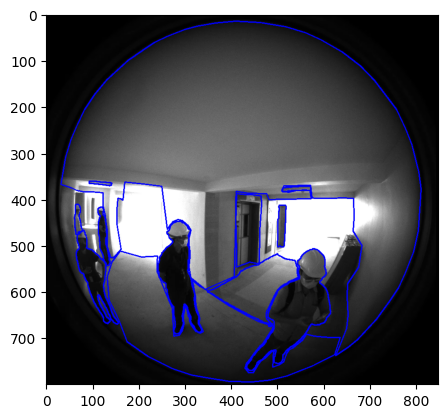

In [29]:
# read image
image = cv2.imread(image_path)

draw_existing_segments(image, label_path)
plt.imshow(image)

# Image Augmentation (TODO)

Converted stream0_20220110_1_frame_10260.png to black and white.


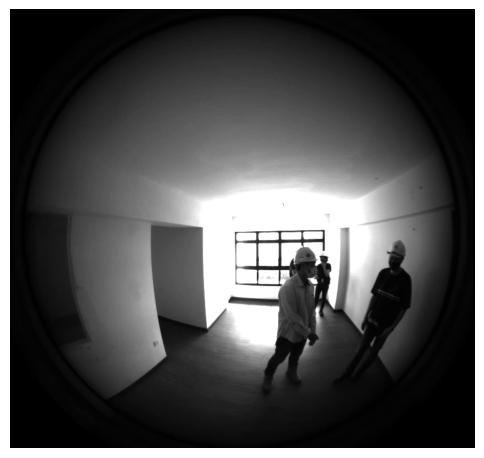

Converted stream0_20220110_1_frame_10800.png to black and white.


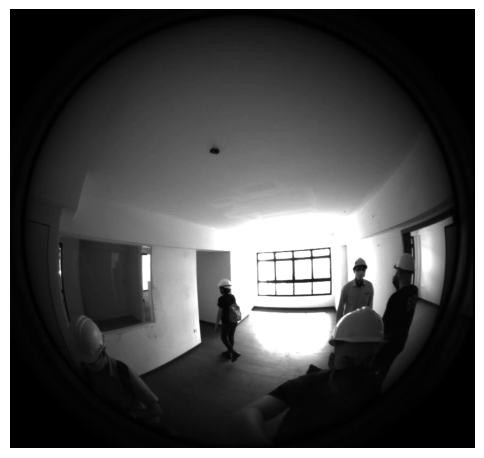

Converted stream0_20220110_1_frame_11520.png to black and white.


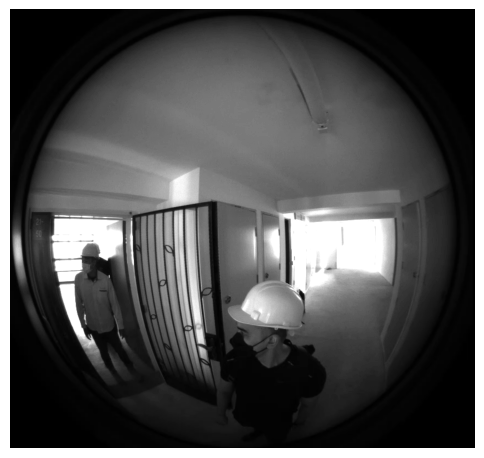

Converted stream0_20220110_1_frame_13860.png to black and white.


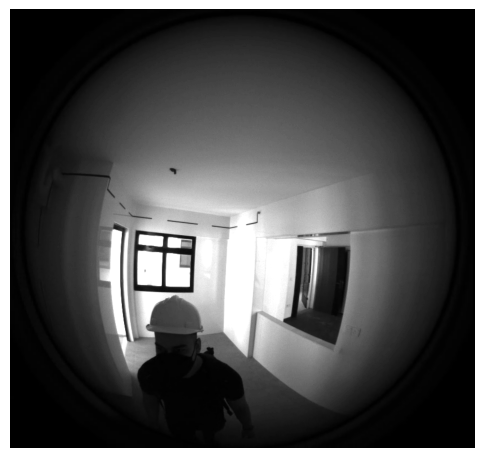

Converted stream0_20220110_1_frame_14760.png to black and white.


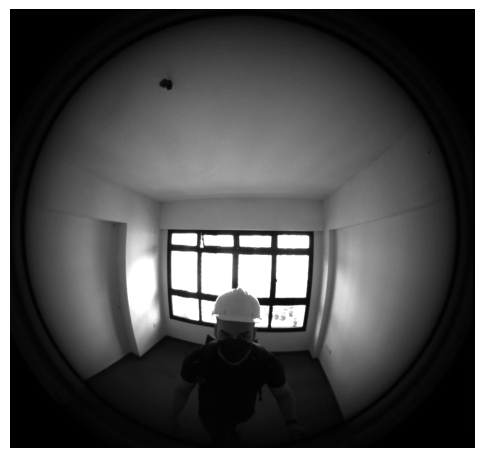

Converted stream0_20220110_1_frame_14940.png to black and white.


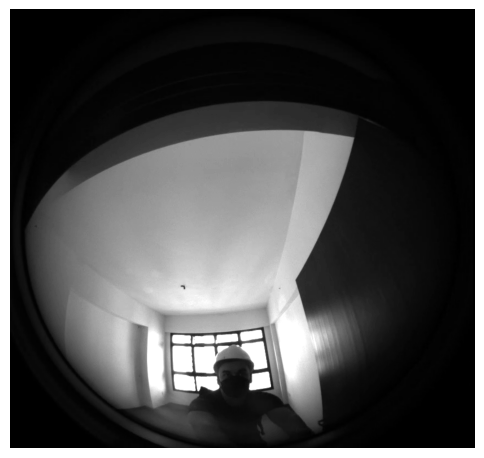

Converted stream0_20220110_1_frame_16200.png to black and white.


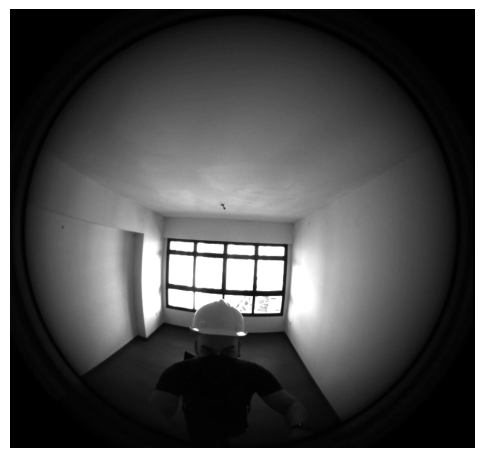

Converted stream0_20220110_1_frame_16560.png to black and white.


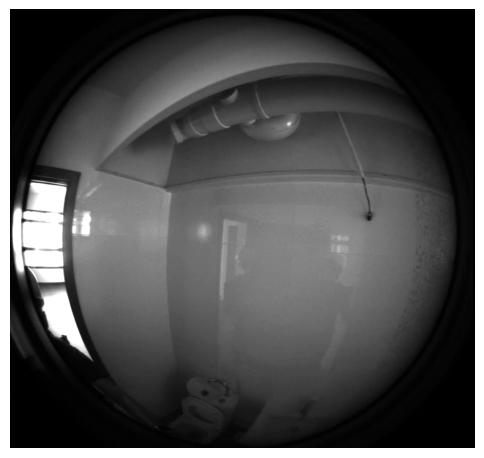

Converted stream0_20220110_1_frame_17100.png to black and white.


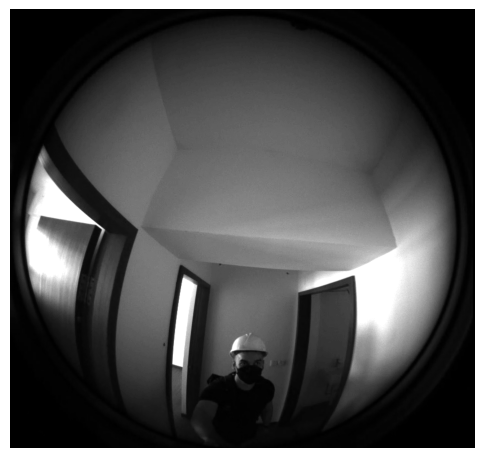

Converted stream0_20220110_1_frame_180.png to black and white.


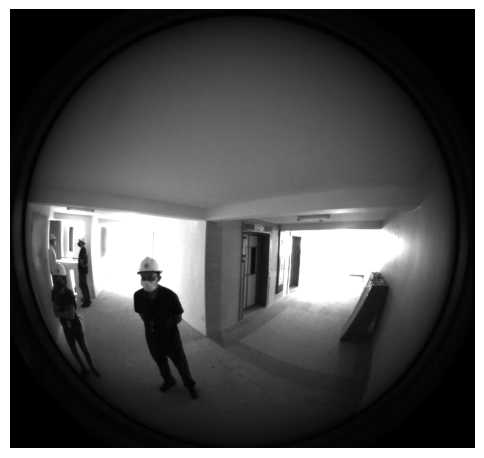

Converted stream0_20220110_1_frame_18000.png to black and white.


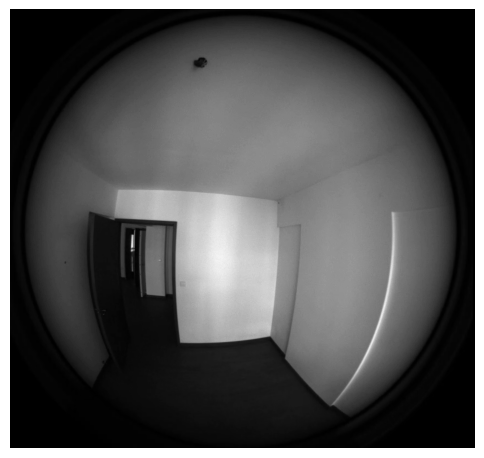

Converted stream0_20220110_1_frame_18540.png to black and white.


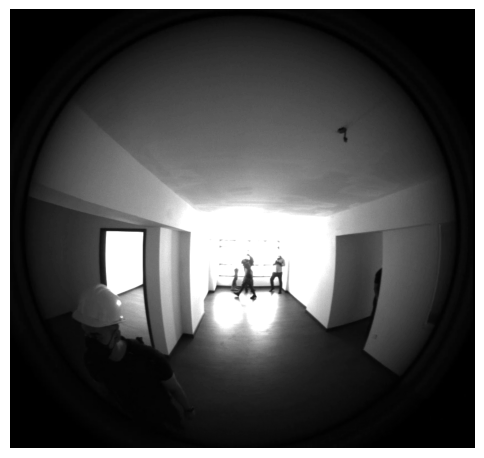

Converted stream0_20220110_1_frame_18720.png to black and white.


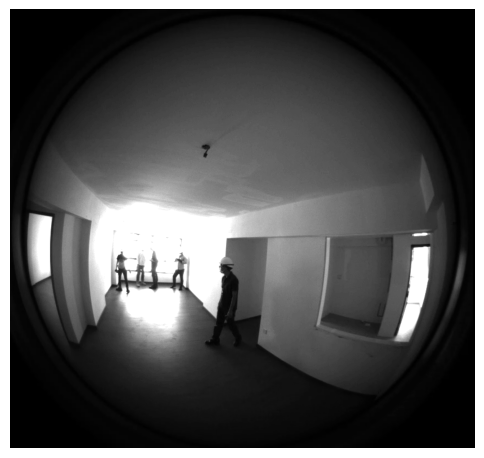

Converted stream0_20220110_1_frame_18900.png to black and white.


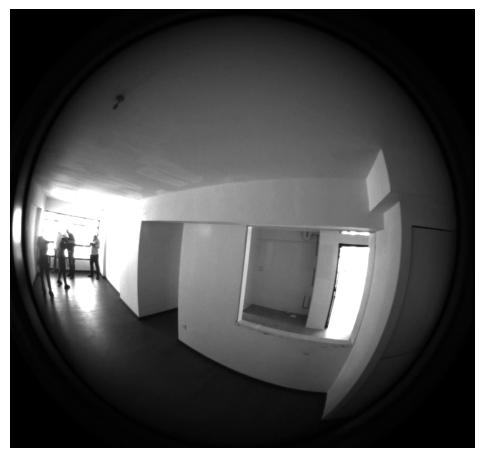

Converted stream0_20220110_1_frame_1980.png to black and white.


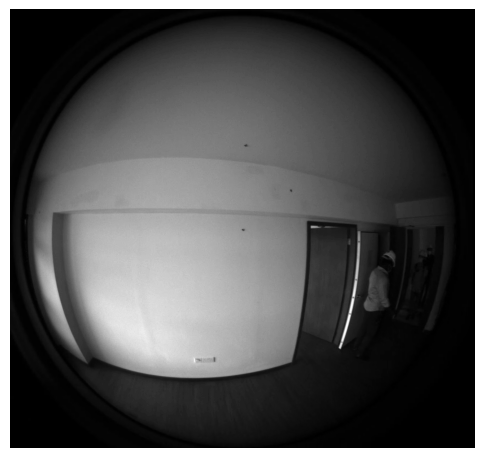

Converted stream0_20220110_1_frame_20160.png to black and white.


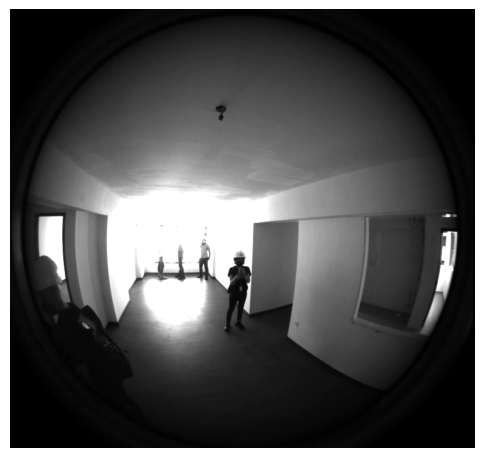

Converted stream0_20220110_1_frame_20520.png to black and white.


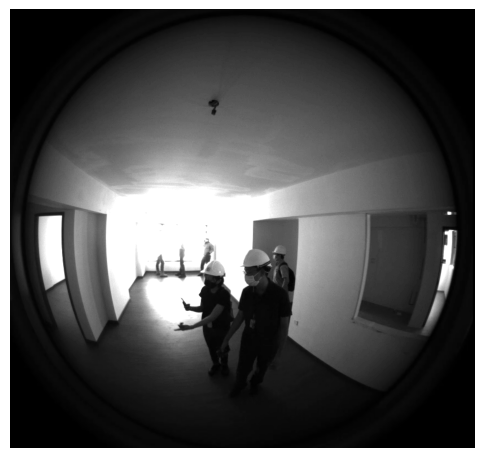

Converted stream0_20220110_1_frame_2700.png to black and white.


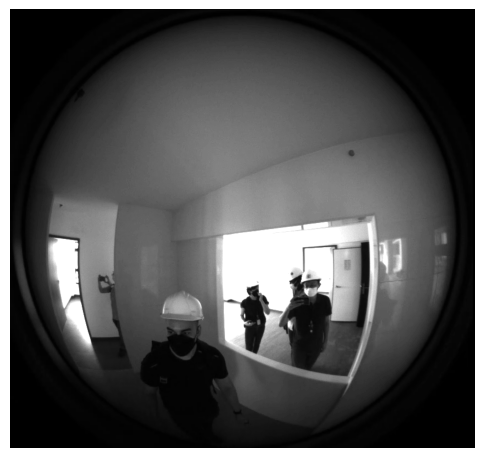

Converted stream0_20220110_1_frame_2880.png to black and white.


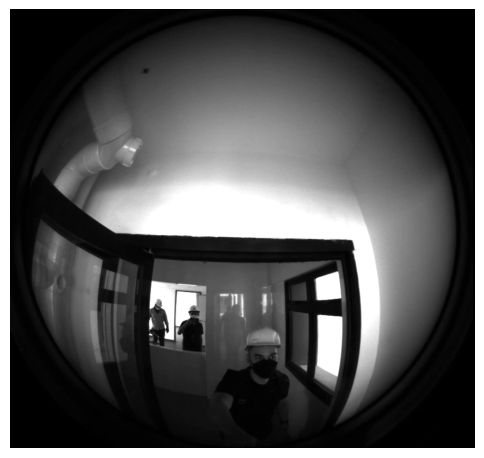

Converted stream0_20220110_1_frame_3240.png to black and white.


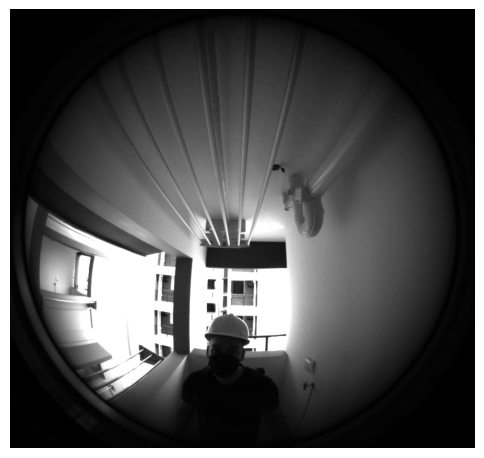

Converted stream0_20220110_1_frame_3960.png to black and white.


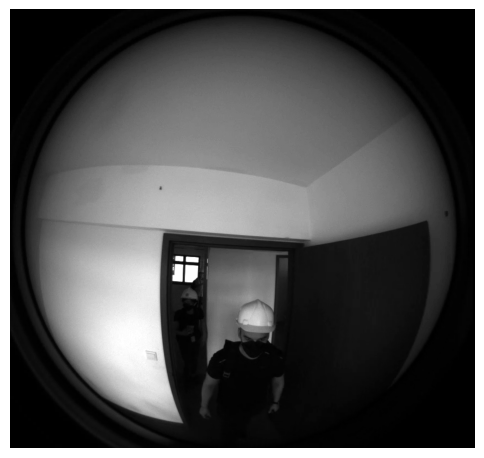

Converted stream0_20220110_1_frame_4140.png to black and white.


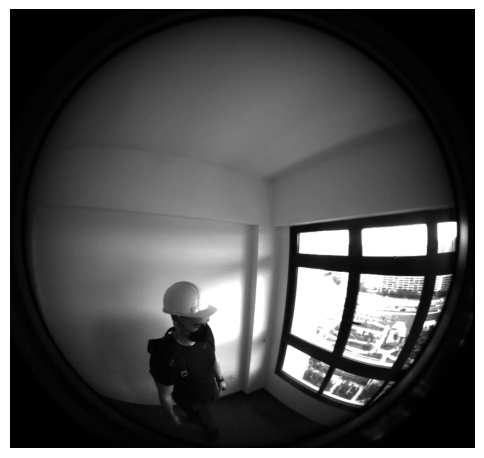

Converted stream0_20220110_1_frame_4320.png to black and white.


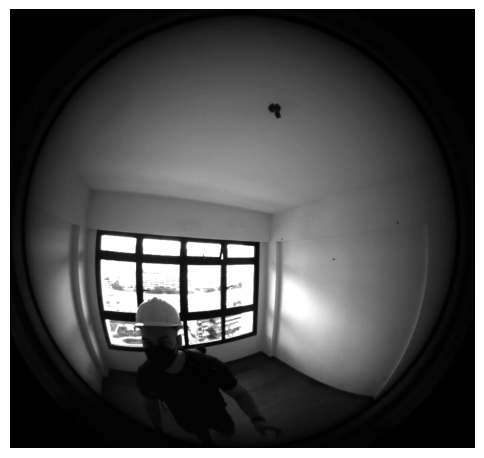

Converted stream0_20220110_1_frame_4860.png to black and white.


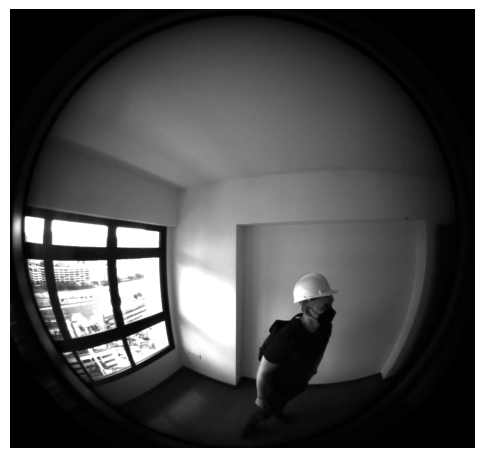

Converted stream0_20220110_1_frame_5040.png to black and white.


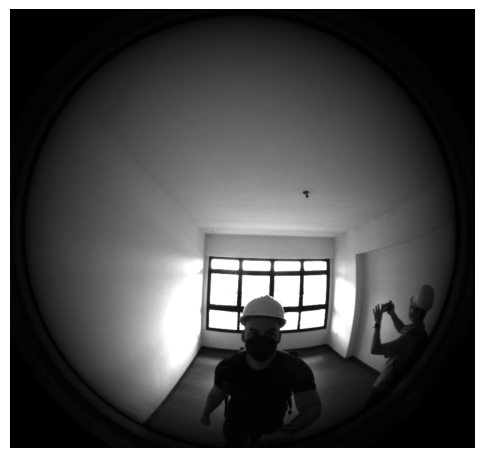

Converted stream0_20220110_1_frame_5580.png to black and white.


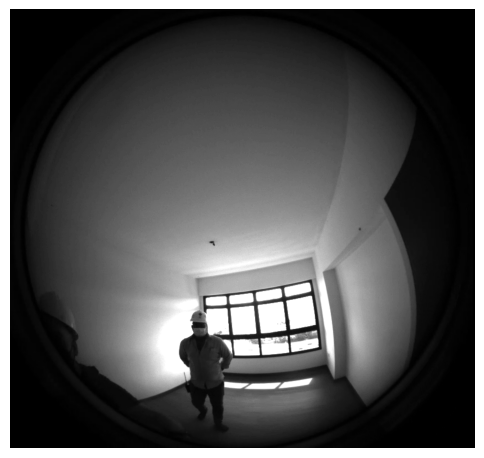

Converted stream0_20220110_1_frame_6480.png to black and white.


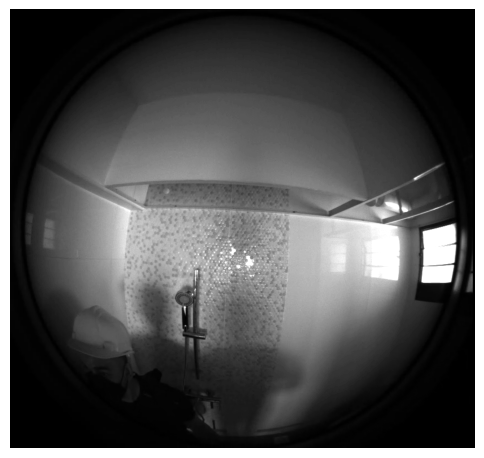

Converted stream0_20220110_1_frame_8280.png to black and white.


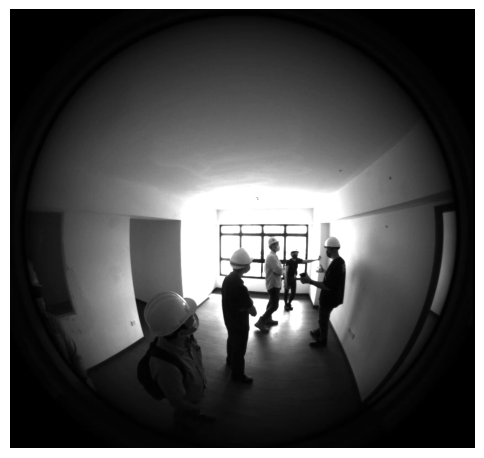

Converted stream0_20220110_1_frame_9900.png to black and white.


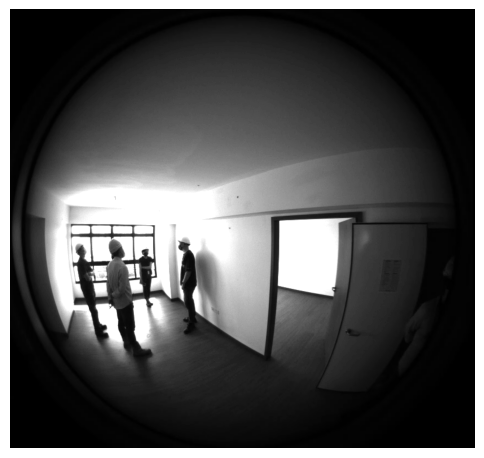

Converted stream0_20220110_2_frame_0.png to black and white.


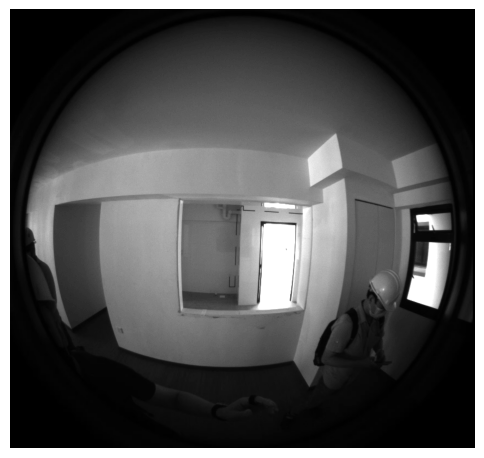

Converted stream0_20220110_2_frame_10080.png to black and white.


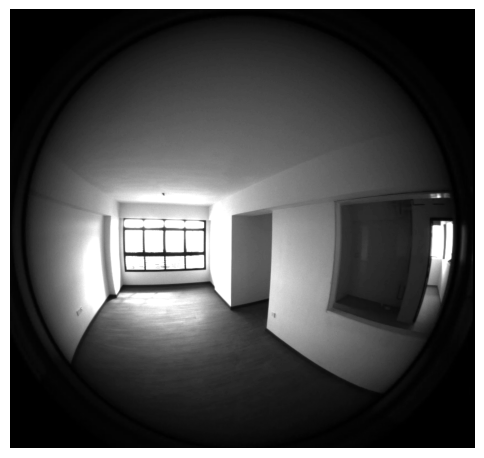

Converted stream0_20220110_2_frame_11340.png to black and white.


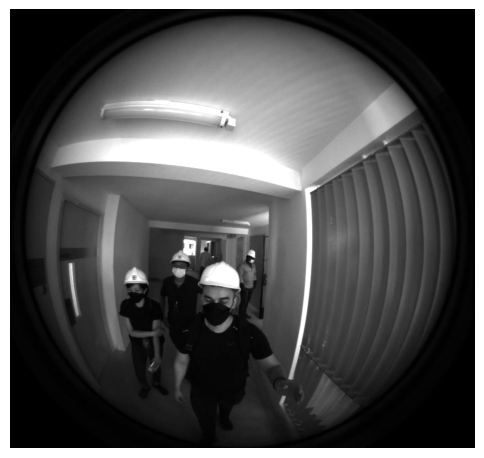

Converted stream0_20220110_2_frame_11700.png to black and white.


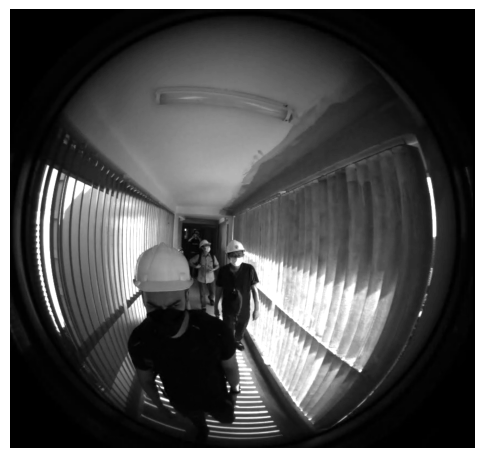

Converted stream0_20220110_2_frame_13500.png to black and white.


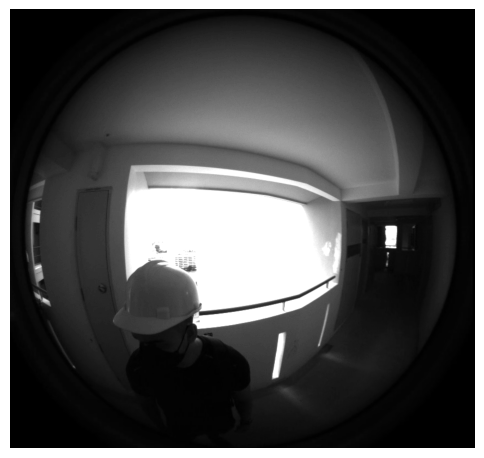

Converted stream0_20220110_2_frame_13680.png to black and white.


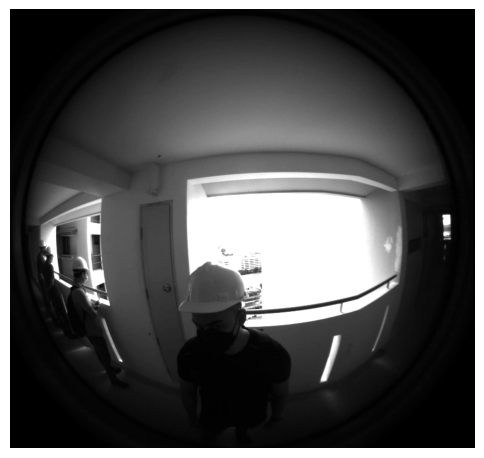

Converted stream0_20220110_2_frame_13860.png to black and white.


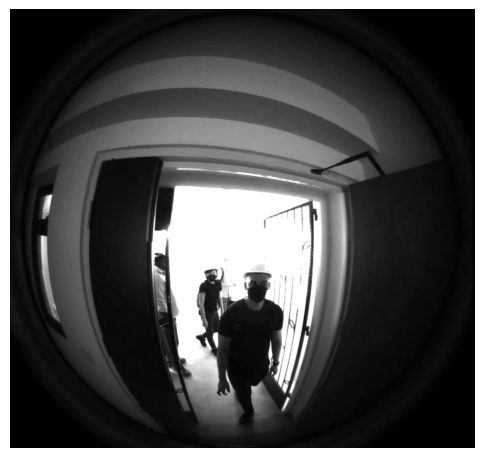

Converted stream0_20220110_2_frame_14220.png to black and white.


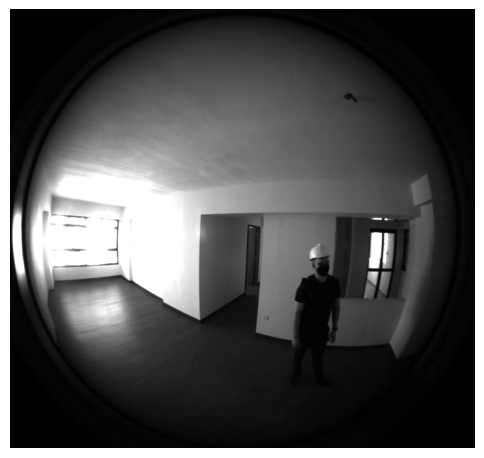

Converted stream0_20220110_2_frame_1440.png to black and white.


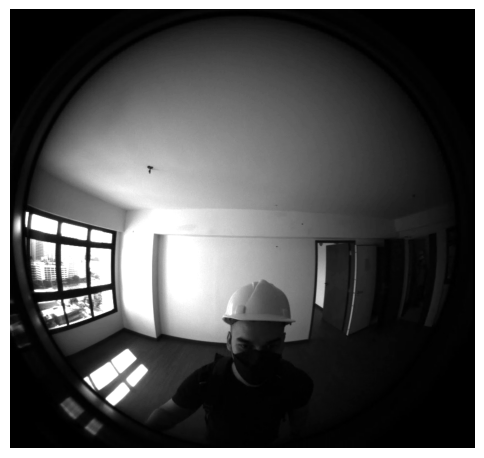

Converted stream0_20220110_2_frame_15840.png to black and white.


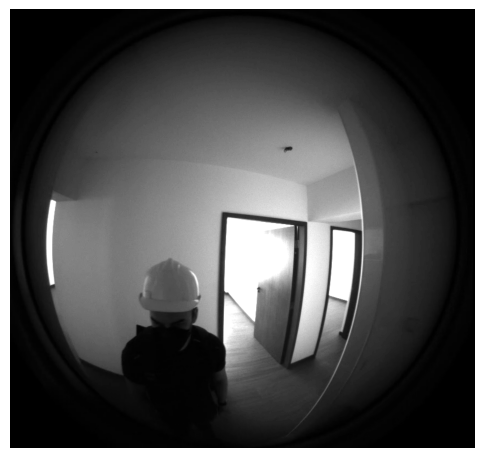

Converted stream0_20220110_2_frame_16200.png to black and white.


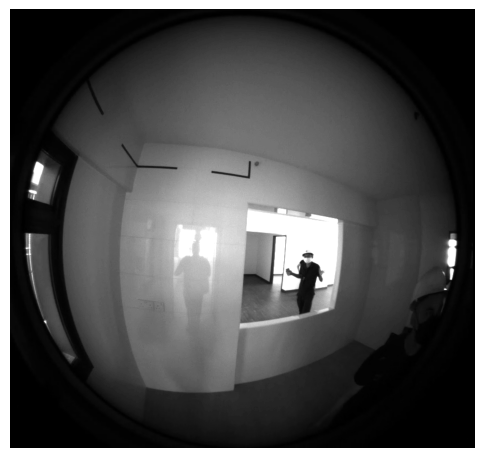

Converted stream0_20220110_2_frame_18720.png to black and white.


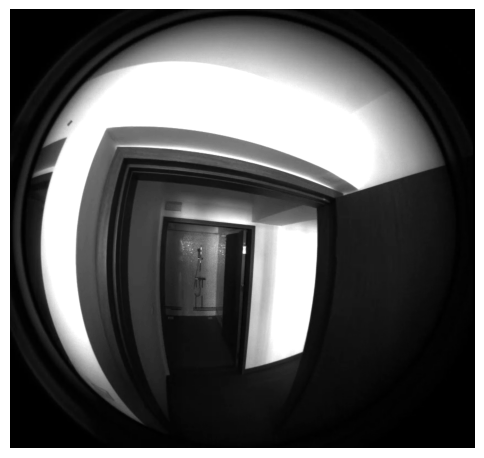

Converted stream0_20220110_2_frame_18900.png to black and white.


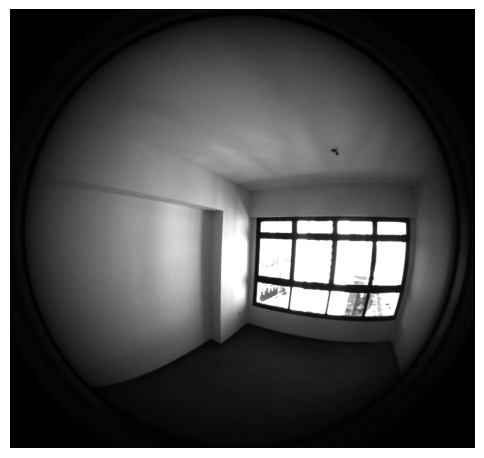

Converted stream0_20220110_2_frame_20340.png to black and white.


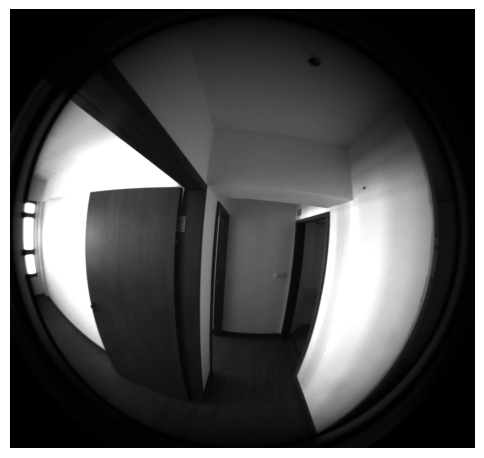

Converted stream0_20220110_2_frame_2160.png to black and white.


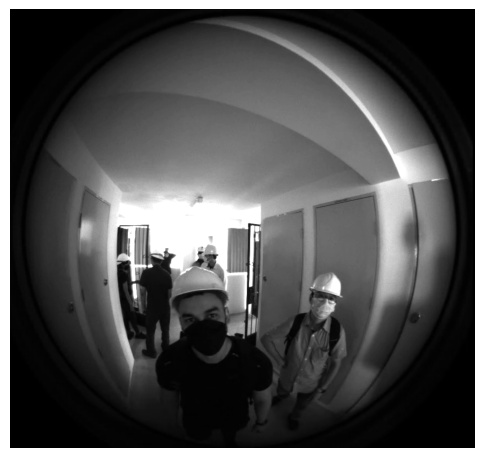

Converted stream0_20220110_2_frame_3060.png to black and white.


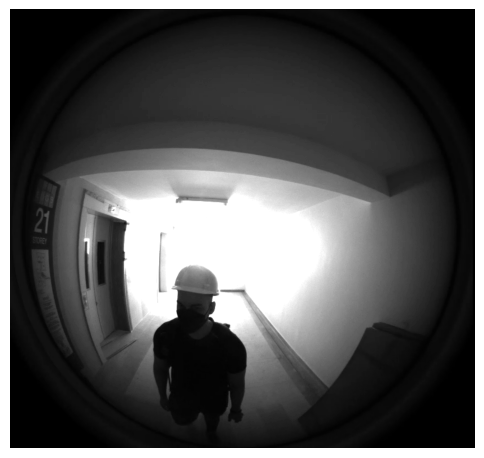

Converted stream0_20220110_2_frame_3240.png to black and white.


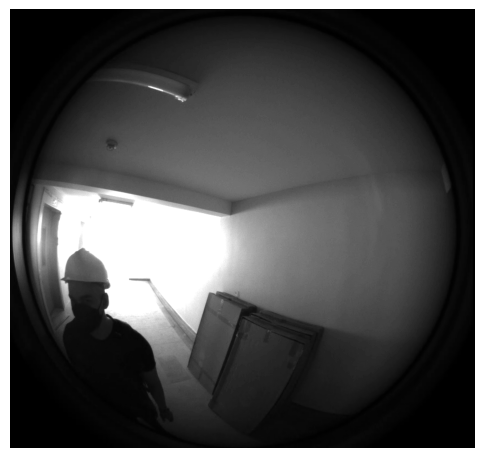

Converted stream0_20220110_2_frame_4860.png to black and white.


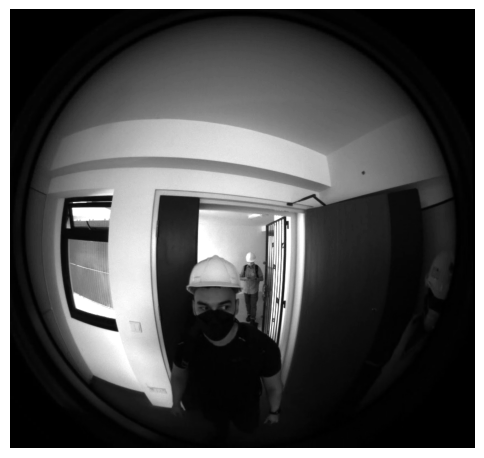

Converted stream0_20220110_2_frame_5940.png to black and white.


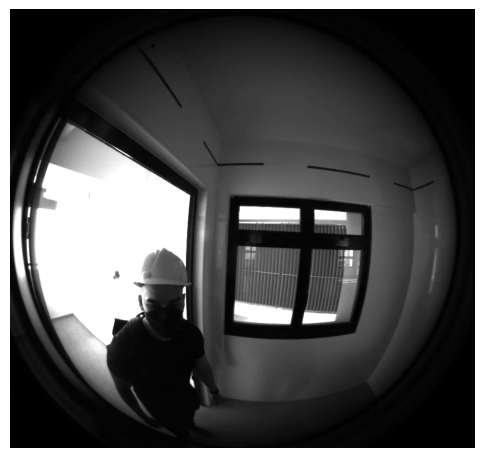

Converted stream0_20220110_2_frame_7380.png to black and white.


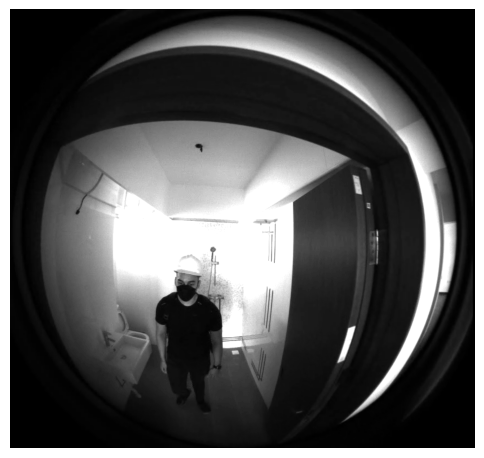

Converted stream0_20220110_2_frame_7560.png to black and white.


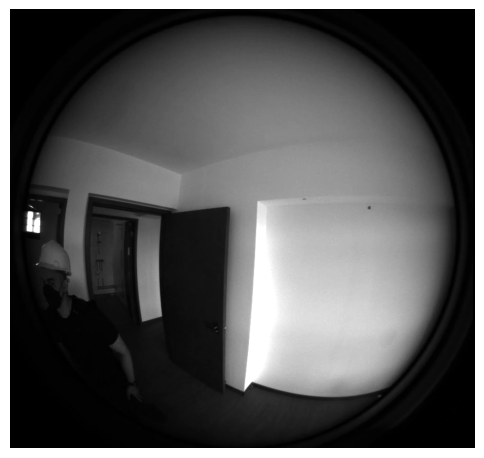

Converted stream0_20220110_2_frame_7920.png to black and white.


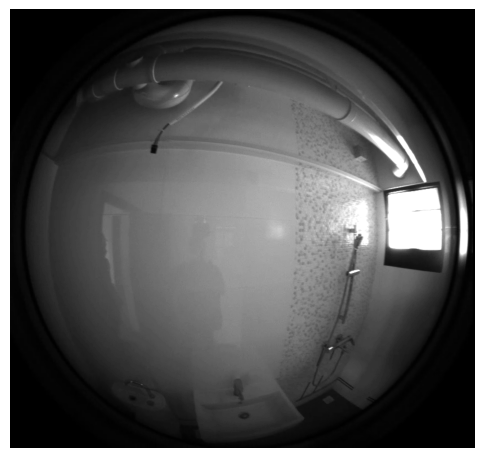

Converted stream0_20220110_2_frame_8820.png to black and white.


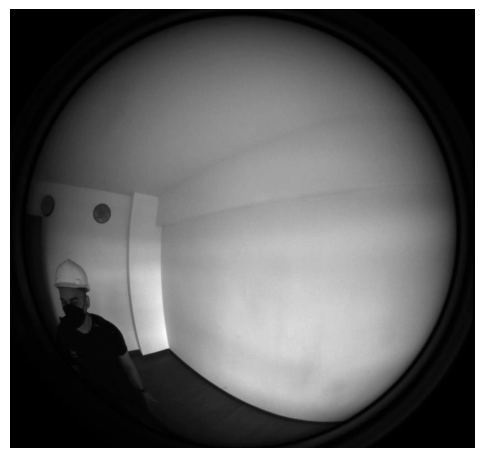

Converted stream0_20220110_2_frame_900.png to black and white.


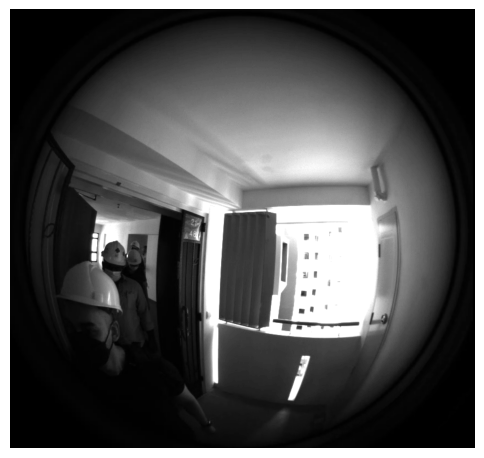

Converted stream0_20220110_2_frame_9000.png to black and white.


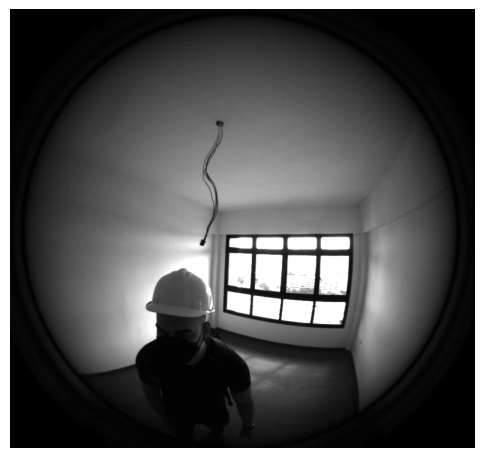

Converted stream0_20220110_3_frame_11340.png to black and white.


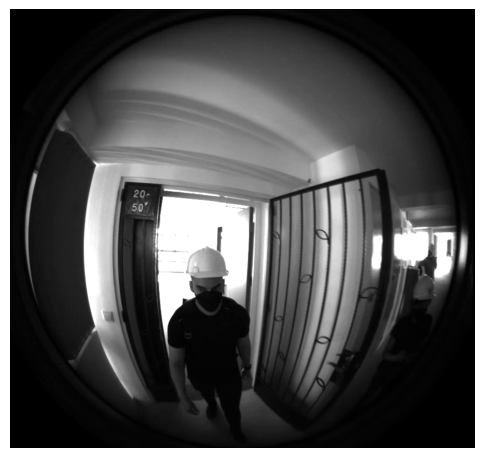

Converted stream0_20220110_3_frame_12240.png to black and white.


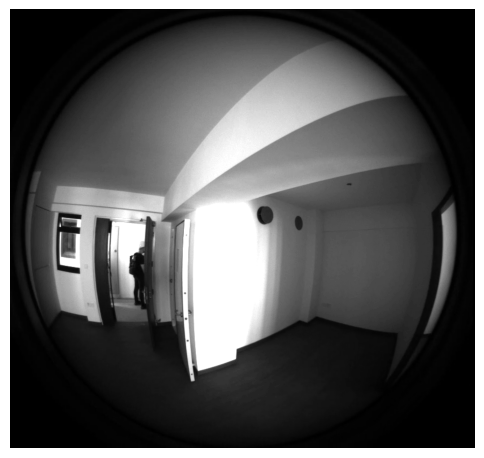

Converted stream0_20220110_3_frame_15120.png to black and white.


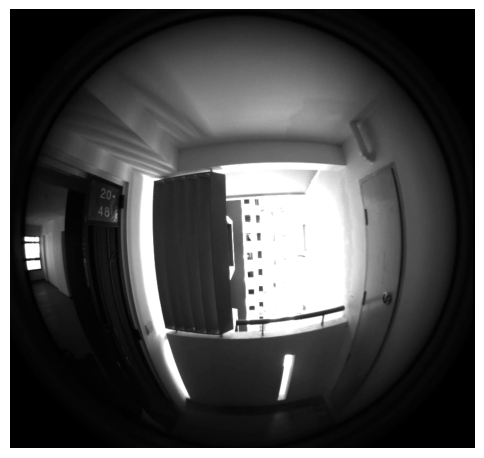

Converted stream0_20220110_3_frame_1800.png to black and white.


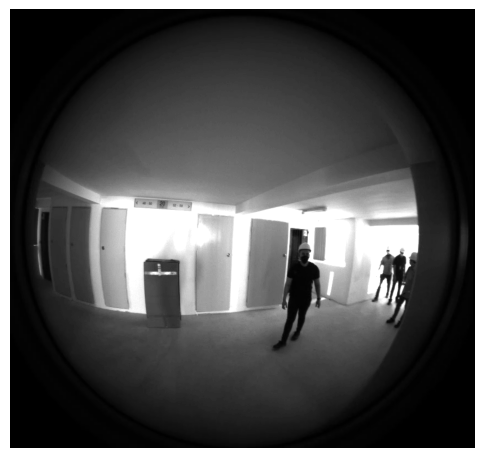

Converted stream0_20220110_3_frame_1980.png to black and white.


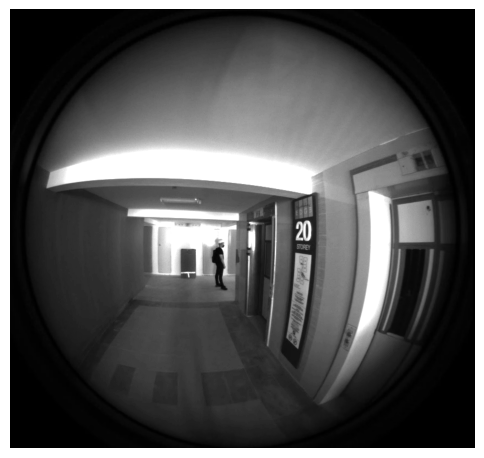

Converted stream0_20220110_3_frame_7560.png to black and white.


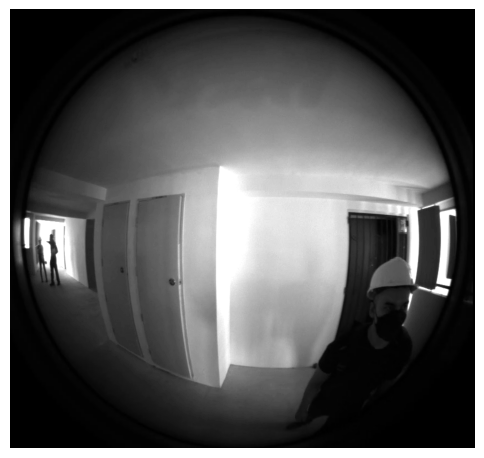

Converted stream0_20220110_3_frame_7920.png to black and white.


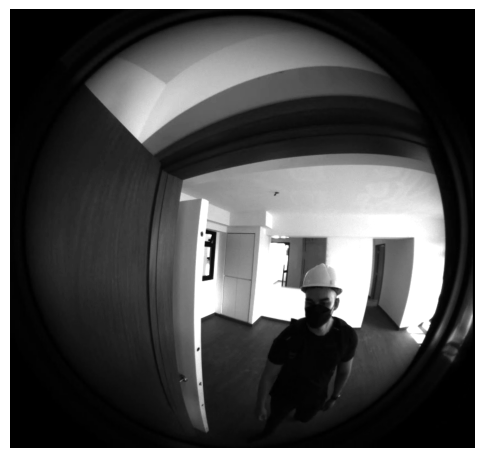

Converted stream0_20220110_3_frame_8280.png to black and white.


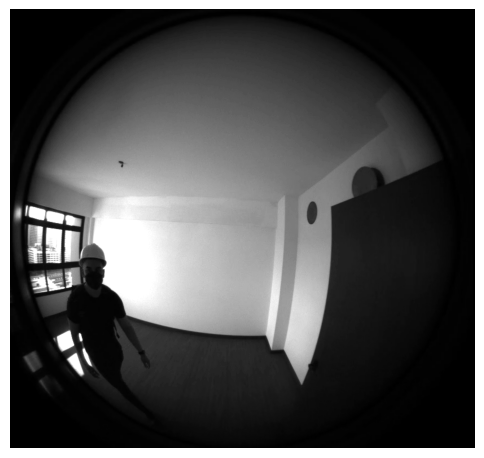

Converted stream0_20220110_3_frame_9000.png to black and white.


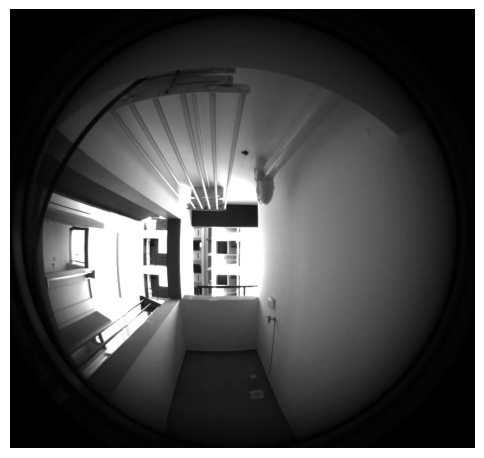

Converted stream0_20220110_ground_frame_1620.png to black and white.


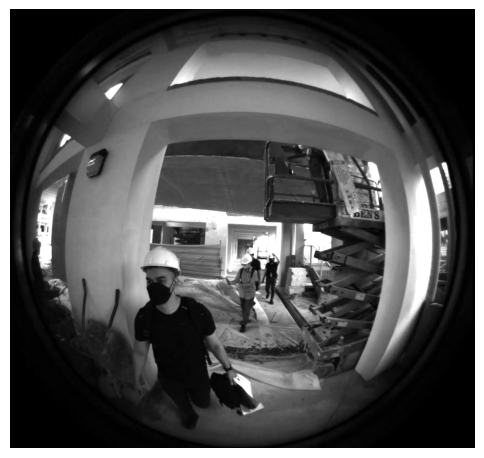

Converted stream0_20220110_ground_frame_2160.png to black and white.


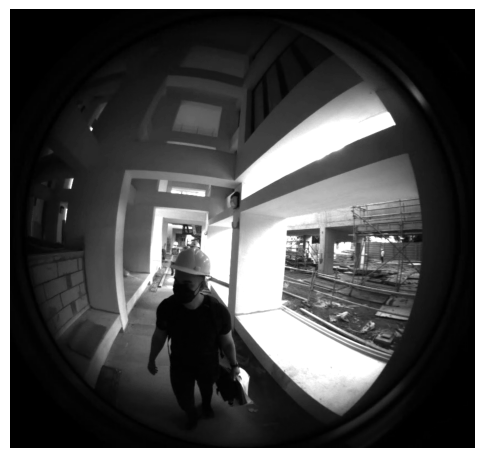

Converted stream0_20220110_ground_frame_2520.png to black and white.


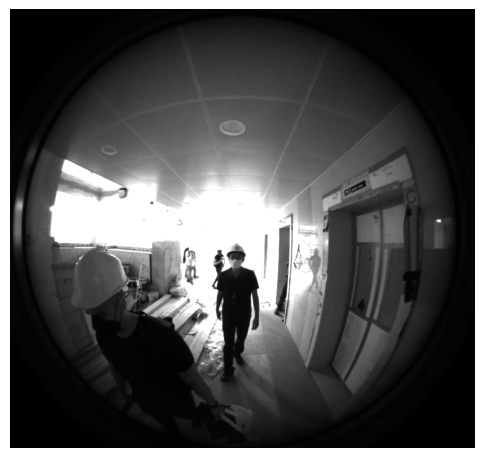

Converted stream0_20220110_ground_frame_4500.png to black and white.


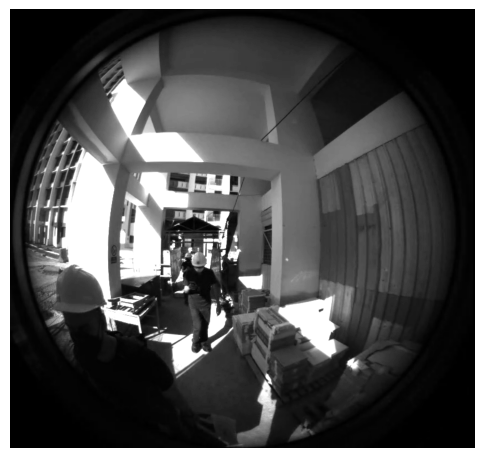

Converted stream0_20220110_ground_frame_4680.png to black and white.


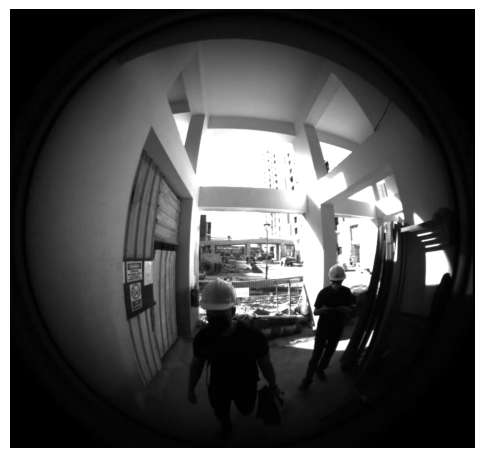

Converted stream0_20220110_ground_frame_4860.png to black and white.


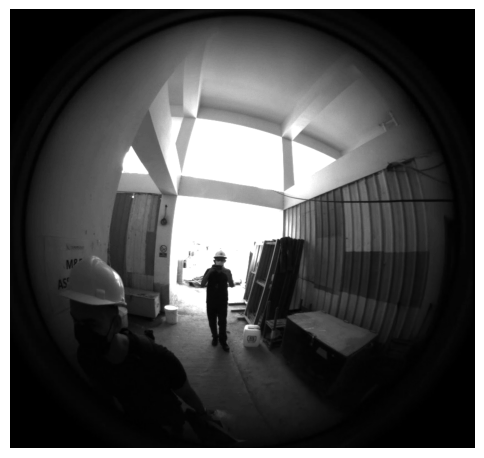

Converted stream0_20220110_ground_frame_5040.png to black and white.


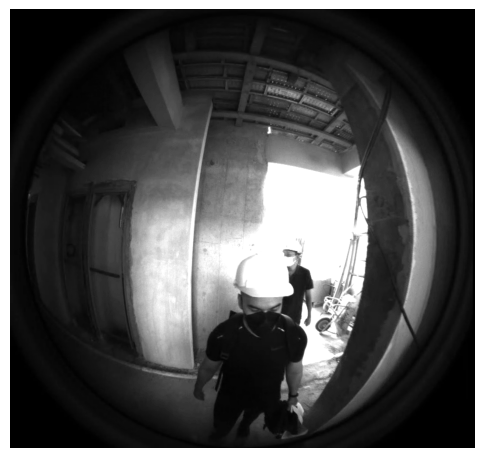

Converted stream0_20220110_ground_frame_540.png to black and white.


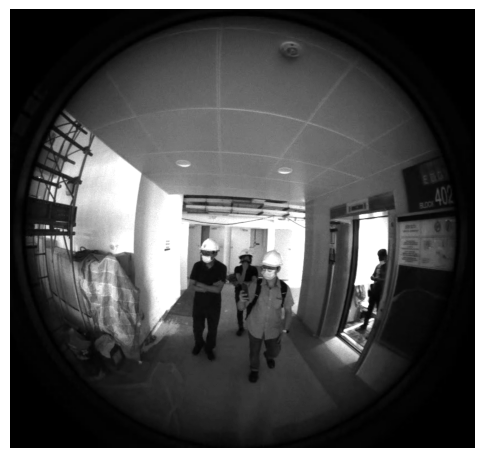

Converted stream0_20220110_ground_frame_5580.png to black and white.


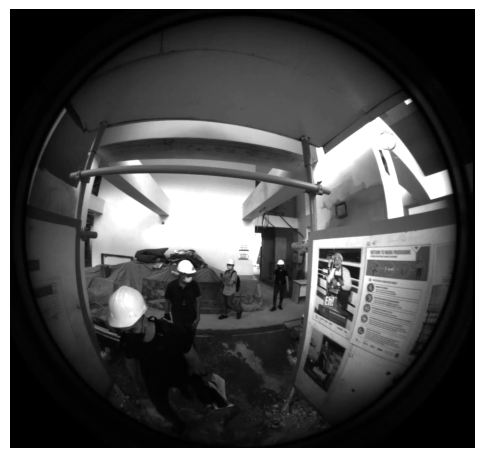

Converted stream0_20220110_ground_frame_6120.png to black and white.


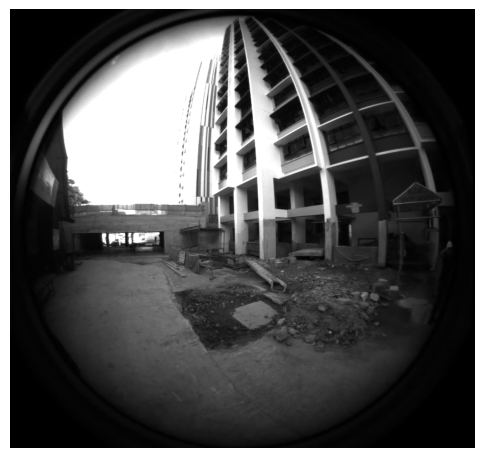

Converted stream0_20220110_ground_frame_6300.png to black and white.


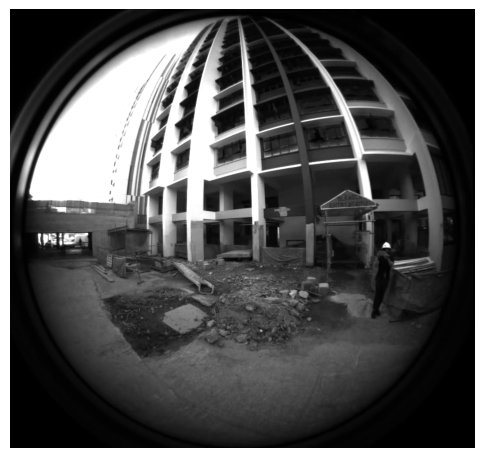

Converted stream0_20220110_ground_frame_900.png to black and white.


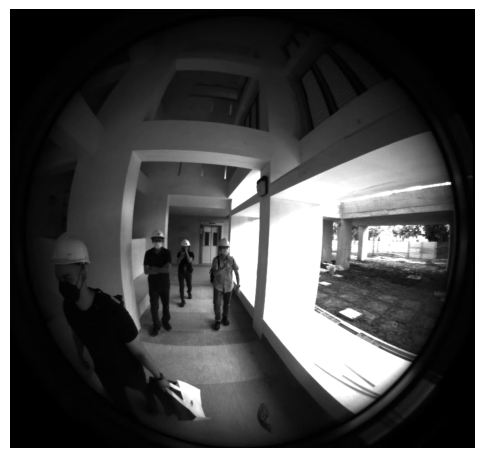

Converted stream0_20220110_stairs_frame_1050.png to black and white.


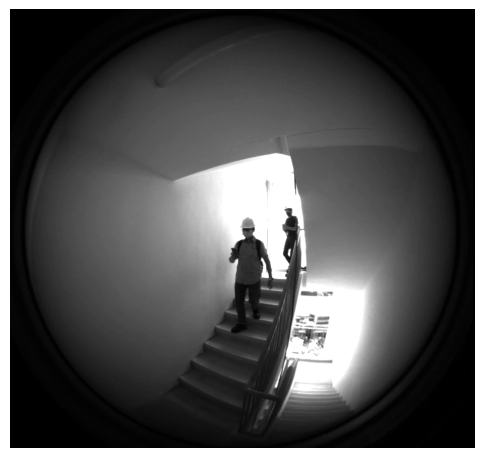

Converted stream0_20220110_stairs_frame_1110.png to black and white.


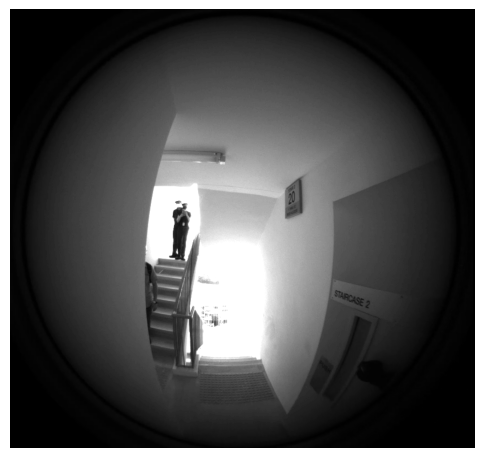

Converted stream0_20220110_stairs_frame_510.png to black and white.


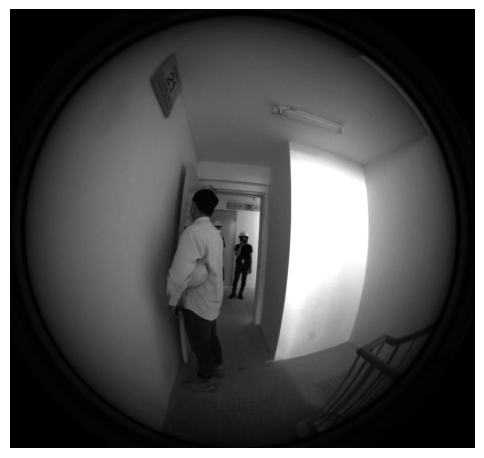

Converted stream0_20220110_stairs_frame_750.png to black and white.


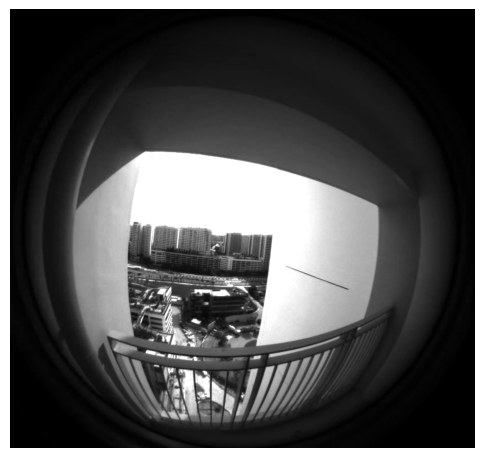

Converted stream0_20220110_stairs_frame_780.png to black and white.


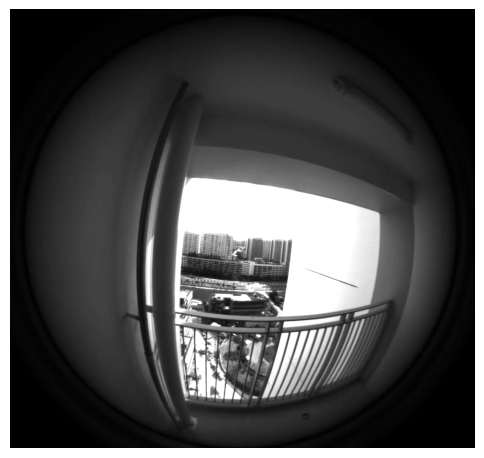

Converted stream0_20220110_stairs_frame_990.png to black and white.


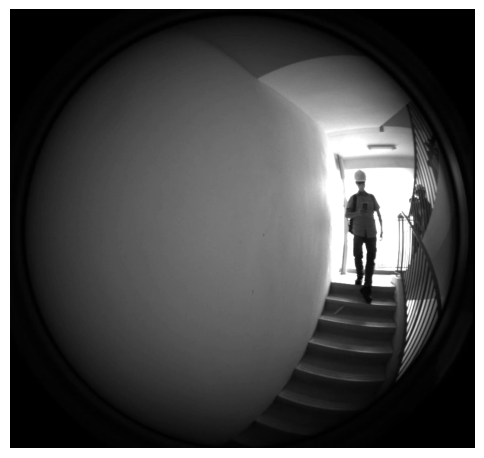

Converted stream0_20220207_ground_frame_10080.png to black and white.


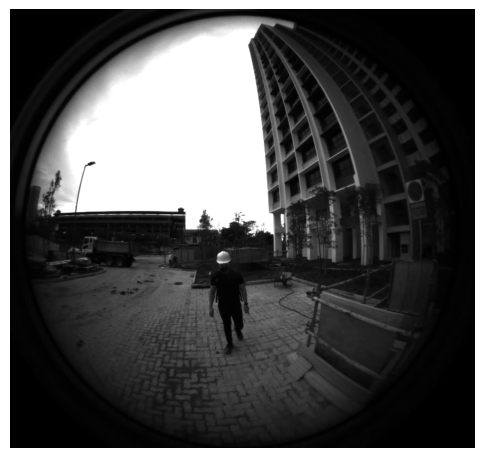

Converted stream0_20220207_ground_frame_10800.png to black and white.


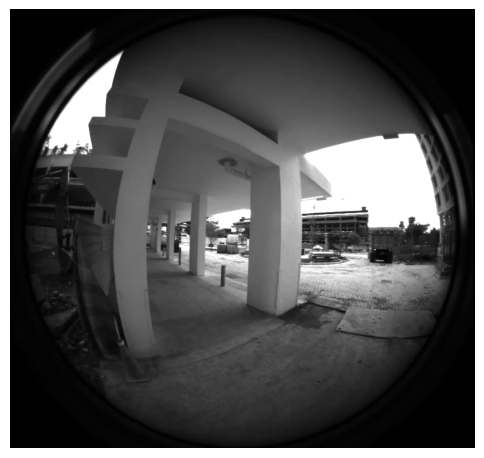

Converted stream0_20220207_ground_frame_10980.png to black and white.


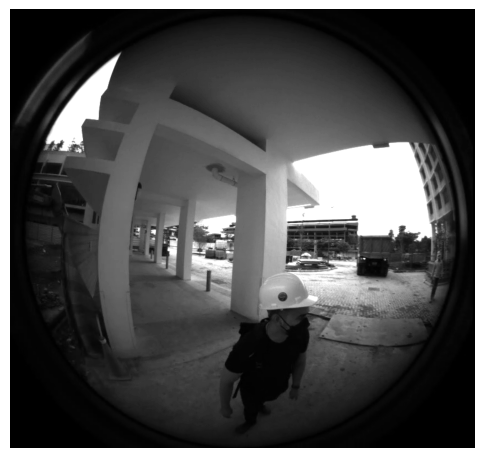

Converted stream0_20220207_ground_frame_12060.png to black and white.


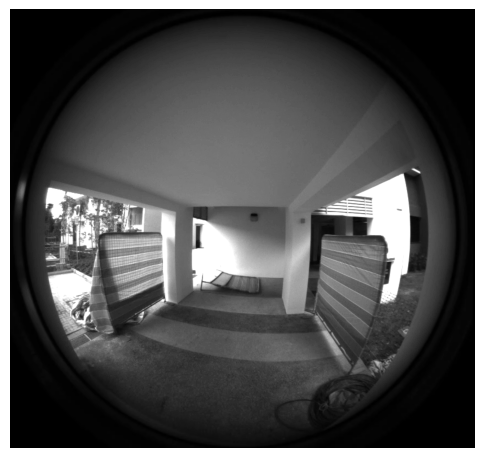

Converted stream0_20220207_ground_frame_12960.png to black and white.


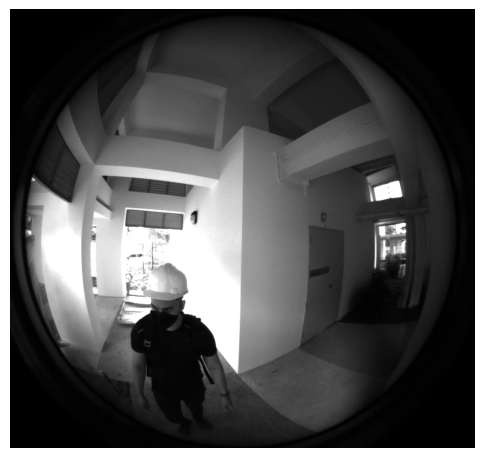

Converted stream0_20220207_ground_frame_14220.png to black and white.


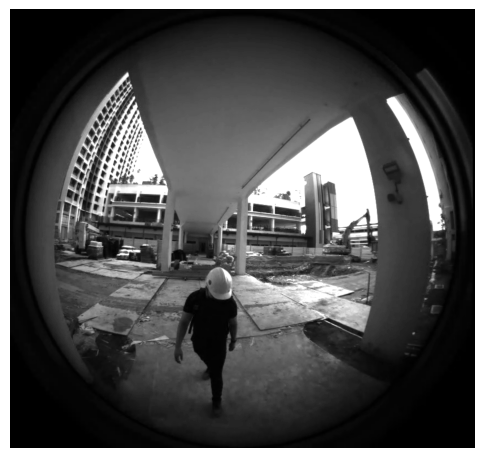

Converted stream0_20220207_ground_frame_14580.png to black and white.


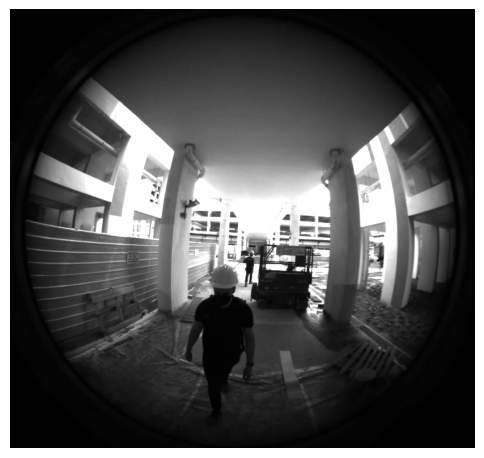

Converted stream0_20220207_ground_frame_15660.png to black and white.


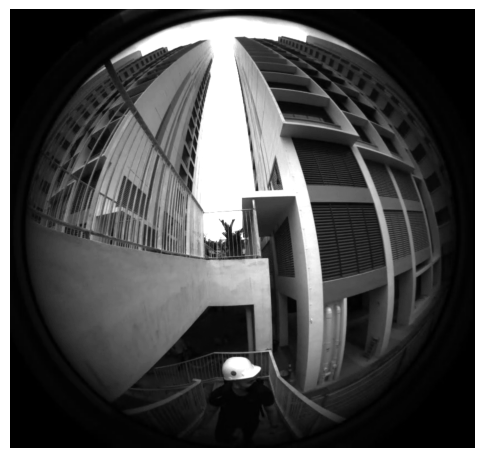

Converted stream0_20220207_ground_frame_2700.png to black and white.


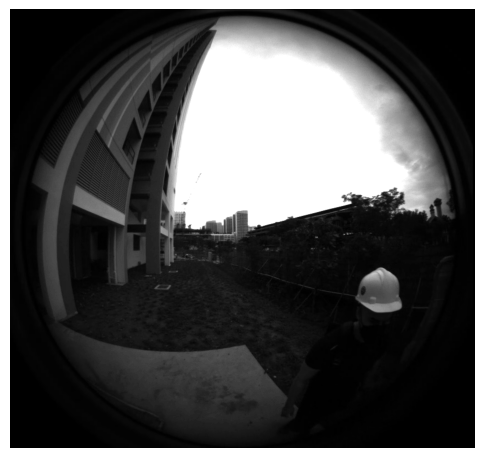

Converted stream0_20220207_ground_frame_3420.png to black and white.


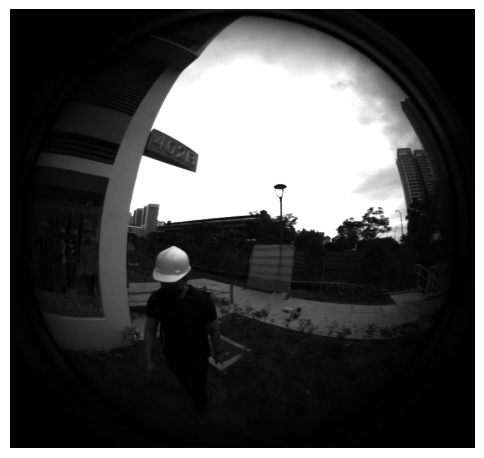

Converted stream0_20220207_ground_frame_360.png to black and white.


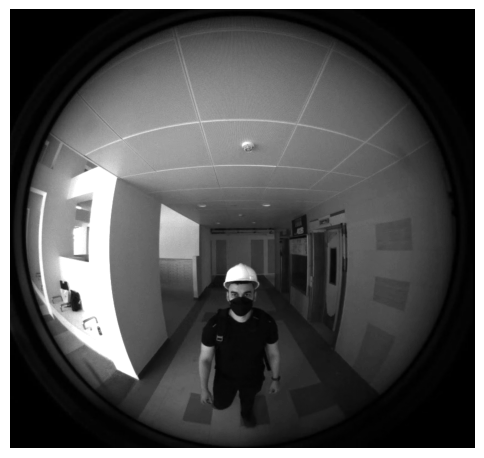

Converted stream0_20220207_ground_frame_4500.png to black and white.


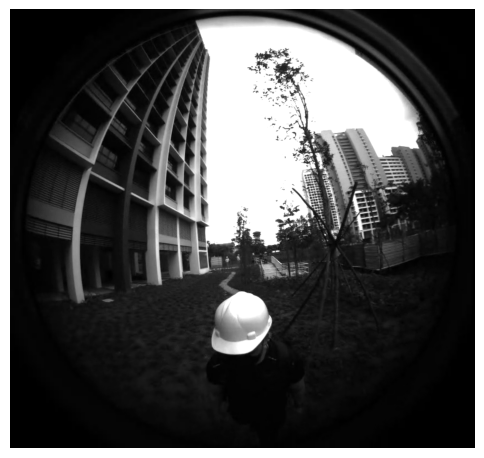

Converted stream0_20220207_ground_frame_5580.png to black and white.


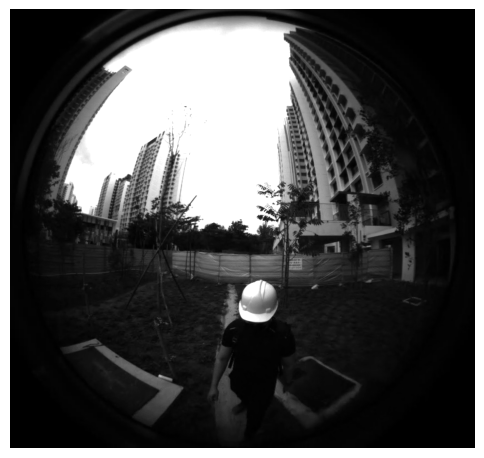

Converted stream0_20220207_ground_frame_6300.png to black and white.


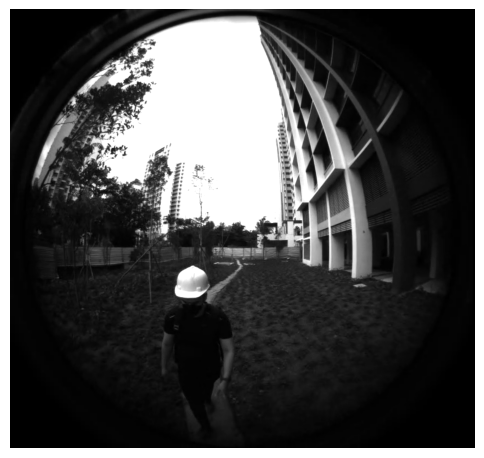

Converted stream0_20220207_ground_frame_7200.png to black and white.


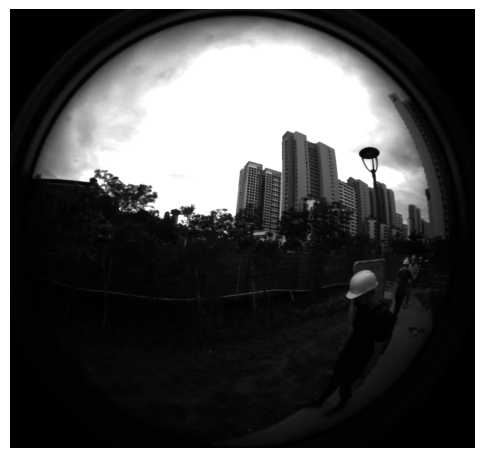

Converted stream0_20220207_ground_frame_9180.png to black and white.


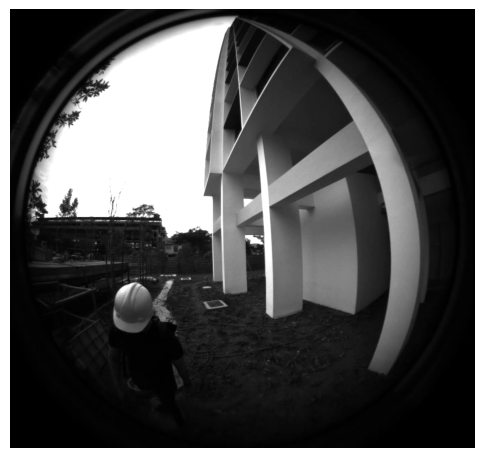

Converted stream0_20220207_L3_frame_14400.png to black and white.


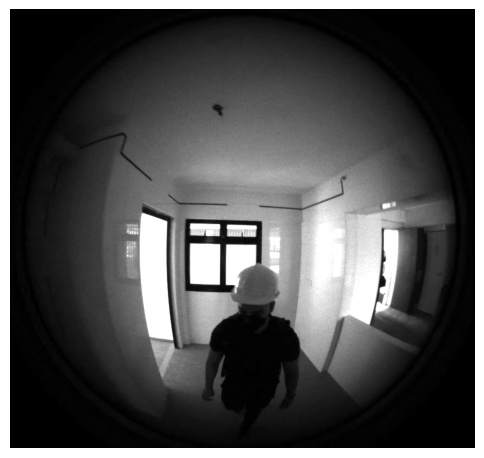

Converted stream0_20220207_L3_frame_15300.png to black and white.


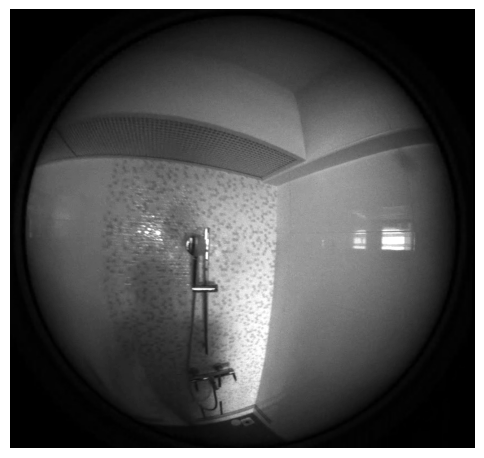

Converted stream0_20220207_L3_frame_2880.png to black and white.


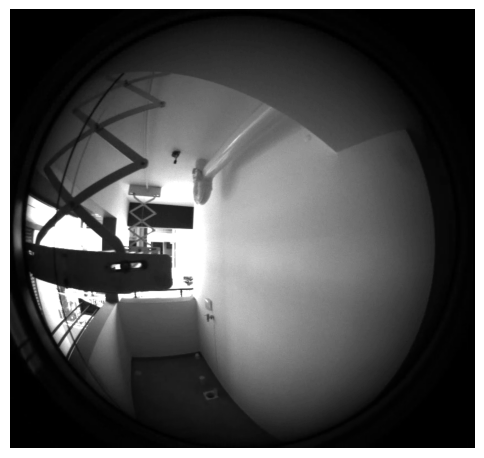

Converted stream0_20220207_l4_frame_10800.png to black and white.


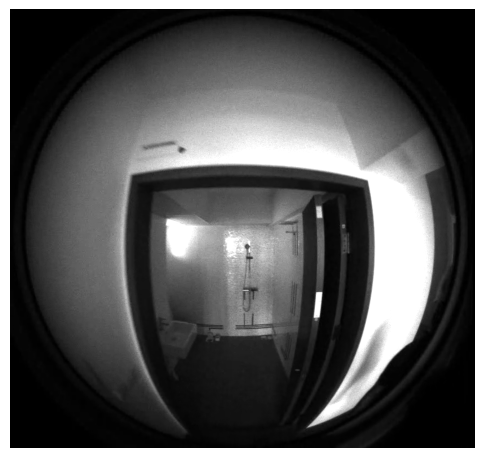

Converted stream0_20220207_l4_frame_13320.png to black and white.


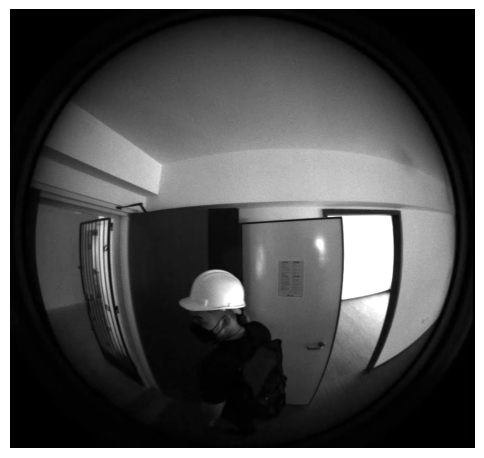

Converted stream0_20220207_L4_gnd_frame_1080.png to black and white.


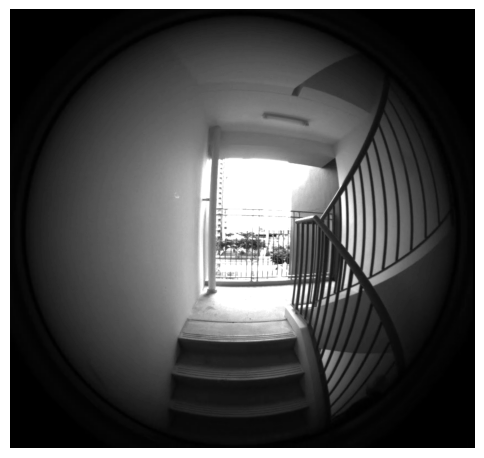

Converted stream0_20220207_L4_gnd_frame_10860.png to black and white.


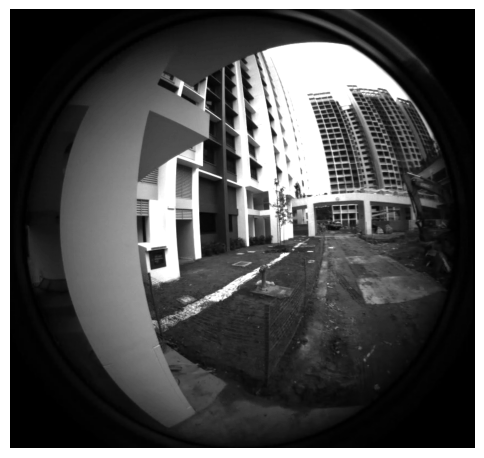

Converted stream0_20220207_L4_gnd_frame_11940.png to black and white.


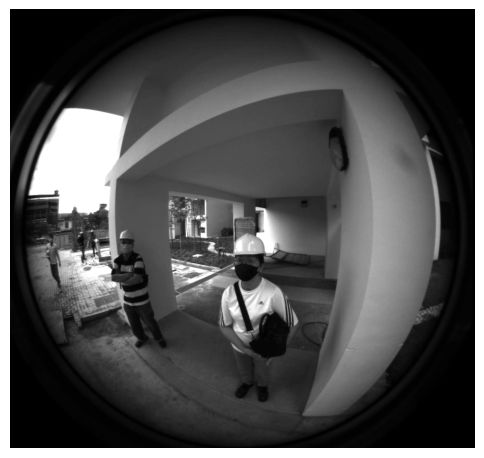

Converted stream0_20220207_L4_gnd_frame_1380.png to black and white.


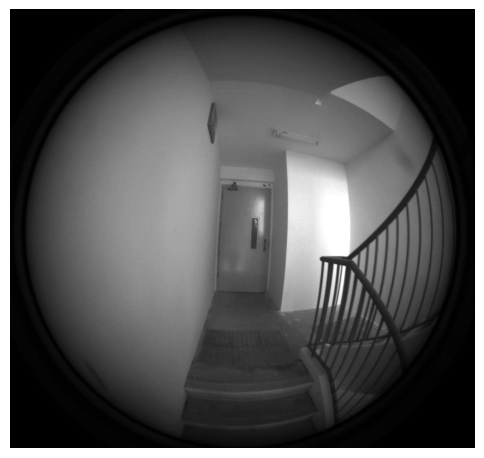

Converted stream0_20220207_L4_gnd_frame_2220.png to black and white.


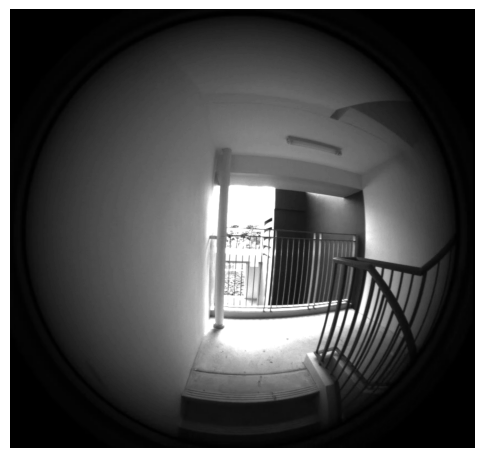

Converted stream0_20220207_L4_gnd_frame_6660.png to black and white.


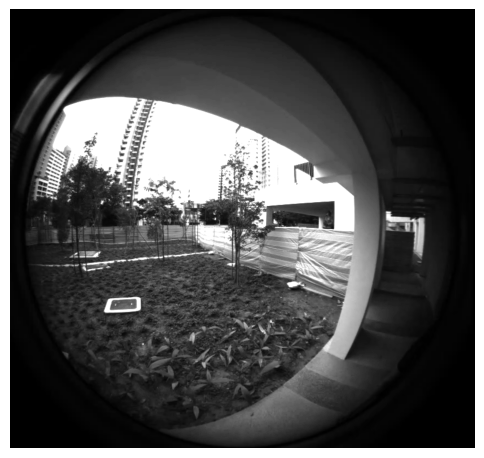

Converted stream0_20220207_L4_gnd_frame_7020.png to black and white.


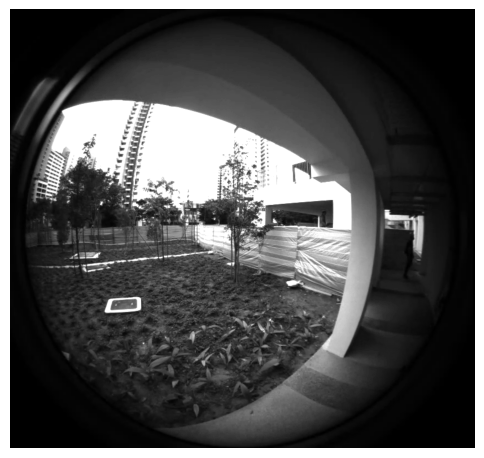

Converted stream0_20220207_L4_gnd_frame_7740.png to black and white.


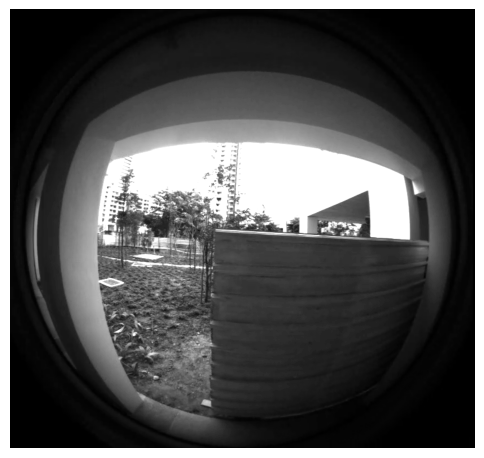

Converted stream0_20220207_L4_gnd_frame_780.png to black and white.


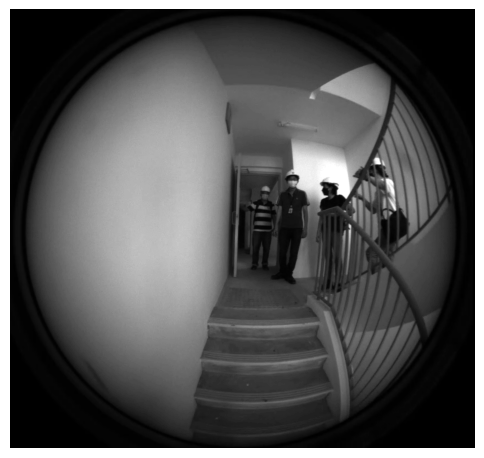

Converted stream0_20220207_L4_gnd_frame_8220.png to black and white.


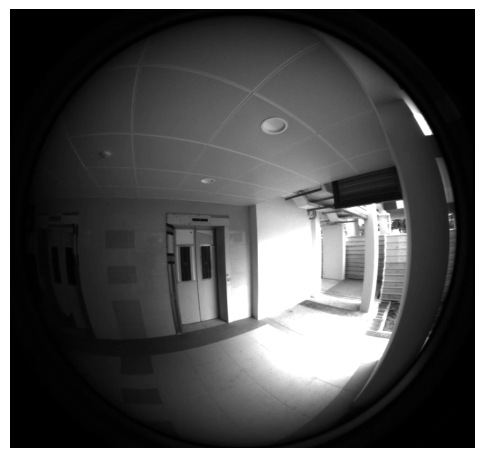

Converted stream0_20220207_L4_gnd_frame_8820.png to black and white.


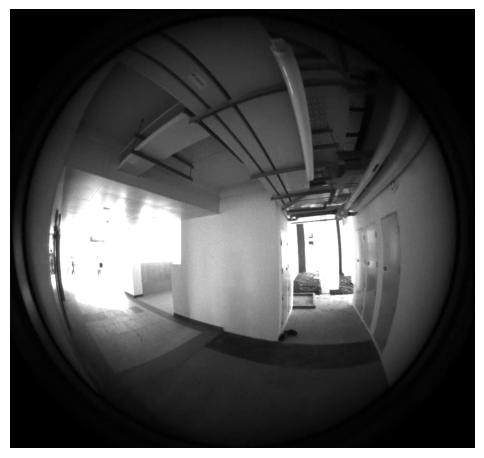

Converted stream0_20220207_L4_gnd_frame_9120.png to black and white.


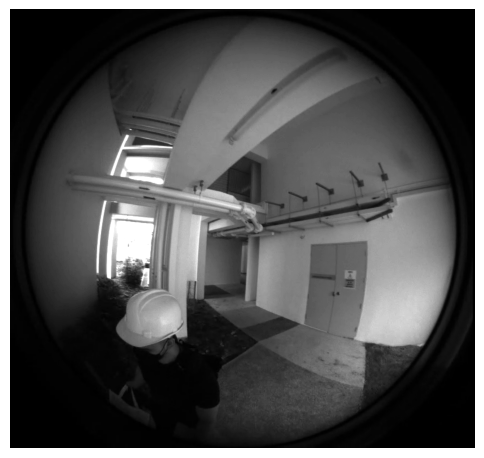

Converted stream0_20220207_L4_gnd_frame_9360.png to black and white.


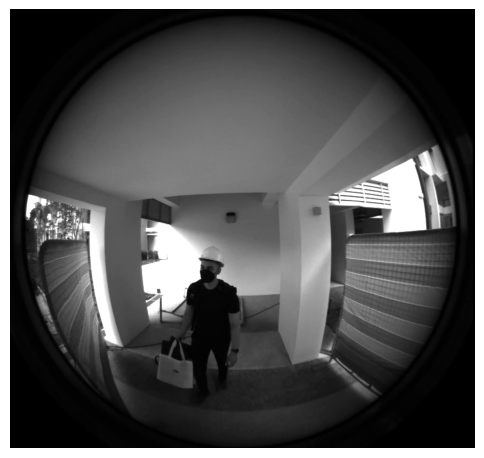

Converted Vid 20230301_135342_10_014_resize_rotated_frame_120.png to black and white.


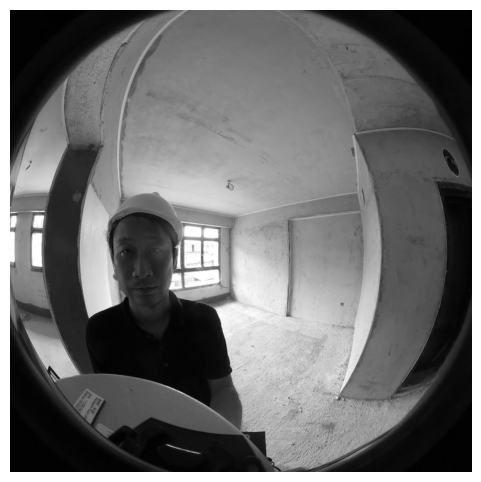

Converted Vid 20230301_135342_10_014_resize_rotated_frame_240.png to black and white.


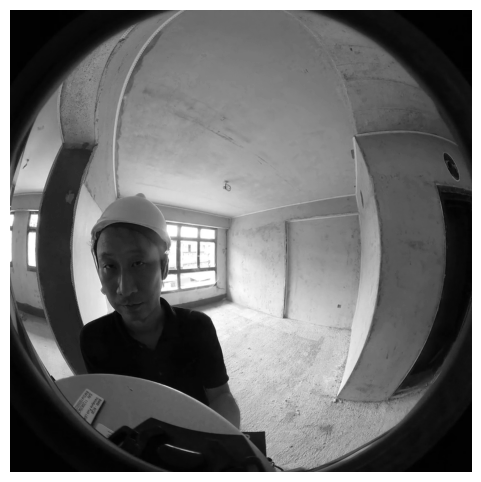

Converted Vid 20230301_135342_10_014_resize_rotated_frame_3360.png to black and white.


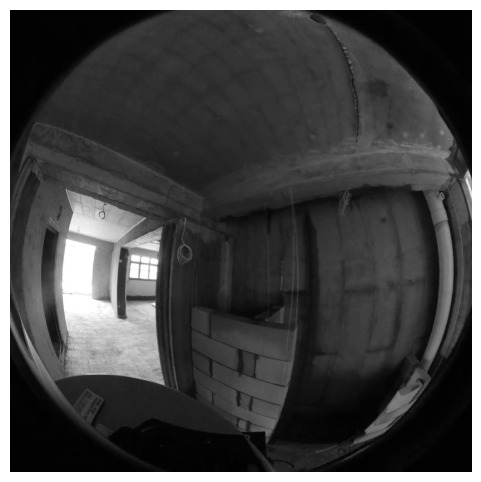

Converted Vid 20230301_135342_10_014_resize_rotated_frame_360.png to black and white.


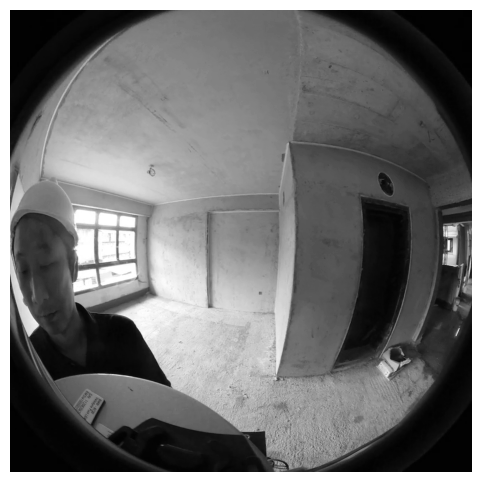

Converted Vid 20230301_135342_10_014_resize_rotated_frame_4200.png to black and white.


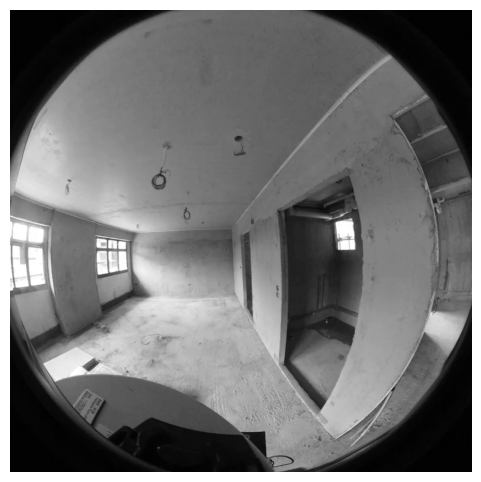

Converted Vid 20230301_135342_10_014_resize_rotated_frame_4680.png to black and white.


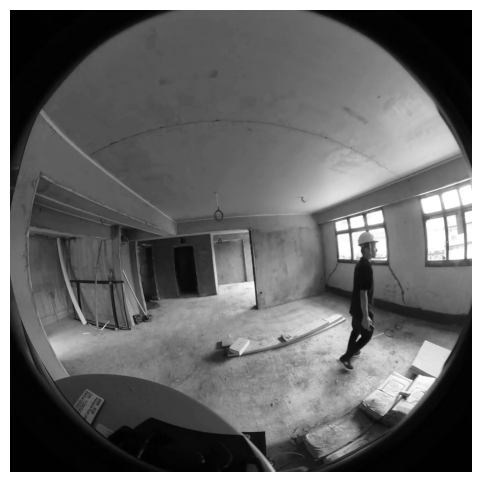

Converted Vid 20230301_135342_10_014_resize_rotated_frame_5640.png to black and white.


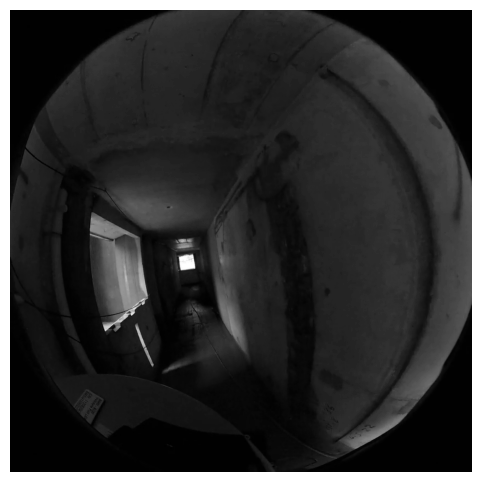

Converted Vid 20230301_135342_10_014_resize_rotated_frame_600.png to black and white.


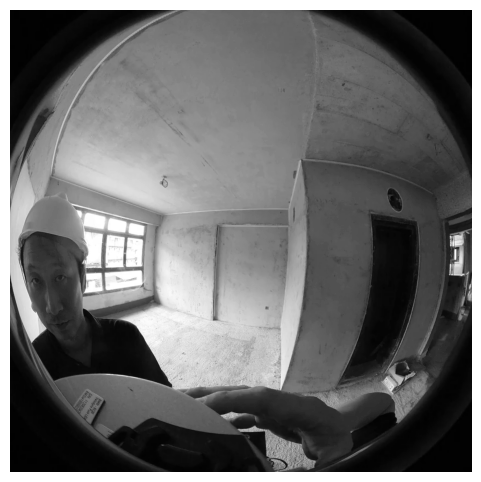

Converted Vid 20230301_135342_10_014_resize_rotated_frame_6480.png to black and white.


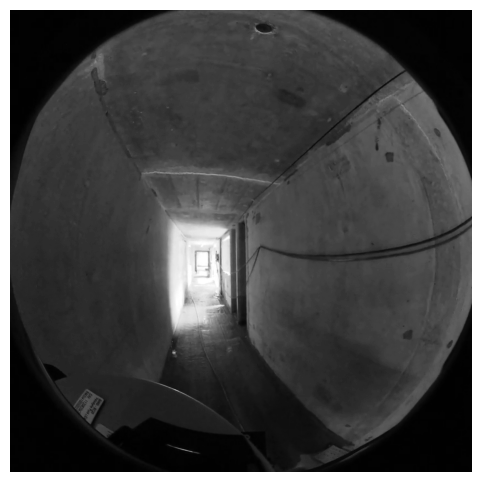

Converted Vid 20230301_135342_10_014_resize_rotated_frame_6600.png to black and white.


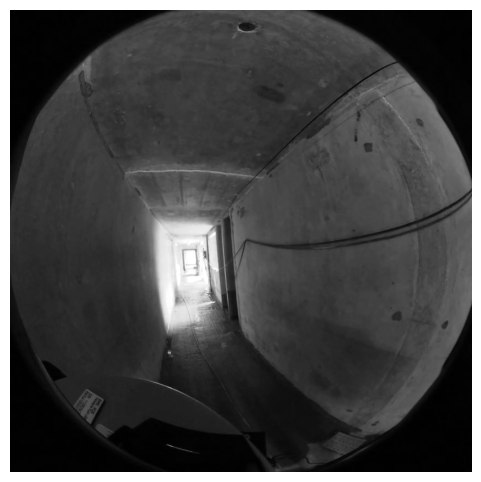

Converted Vid 20230301_135342_10_014_resize_rotated_frame_7560.png to black and white.


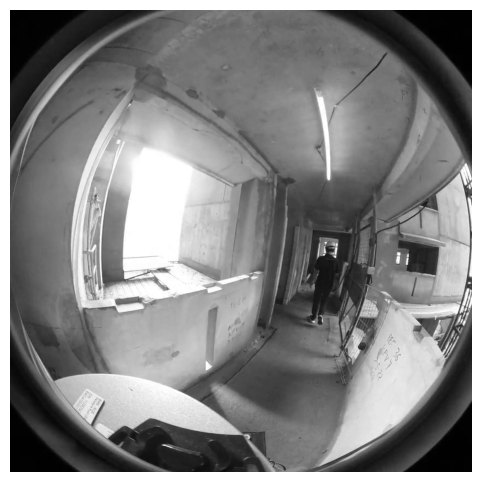

Converted Vid 20230301_135342_10_014_resize_rotated_frame_7680.png to black and white.


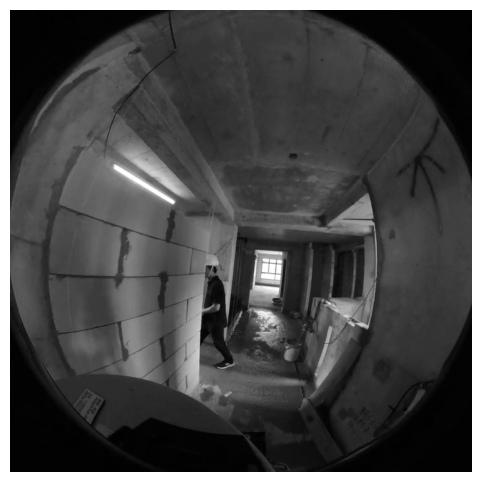

Converted Vid_20230220_110705_10_012_resize_rotated_frame_1080.png to black and white.


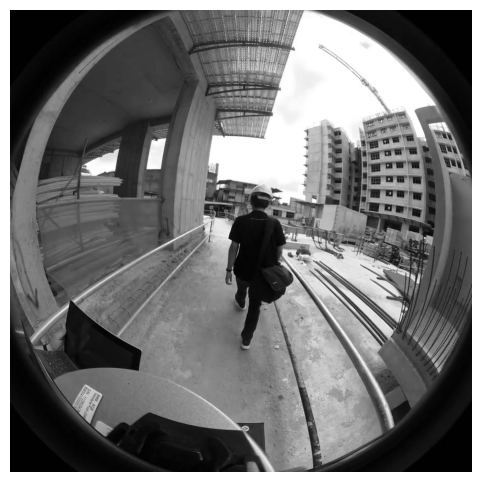

Converted Vid_20230220_110705_10_012_resize_rotated_frame_15120.png to black and white.


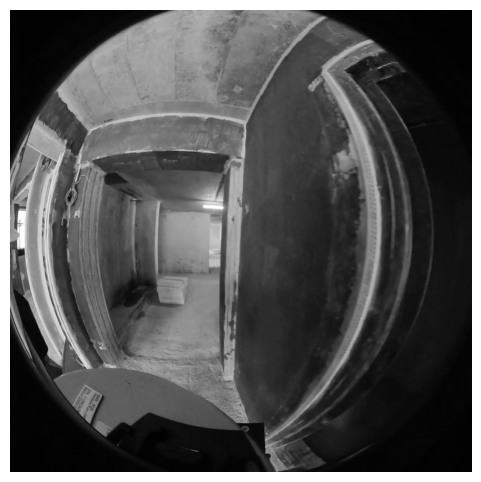

Converted Vid_20230220_110705_10_012_resize_rotated_frame_25920.png to black and white.


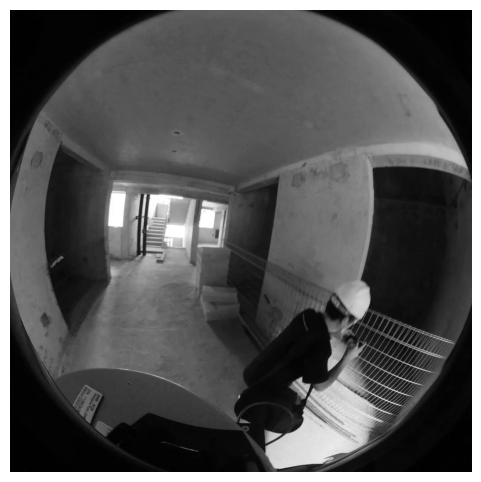

Converted Vid_20230220_110705_10_012_resize_rotated_frame_31320.png to black and white.


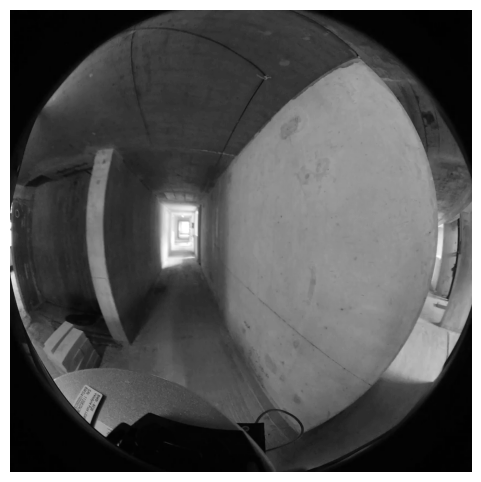

Converted Vid_20230220_110705_10_012_resize_rotated_frame_5400.png to black and white.


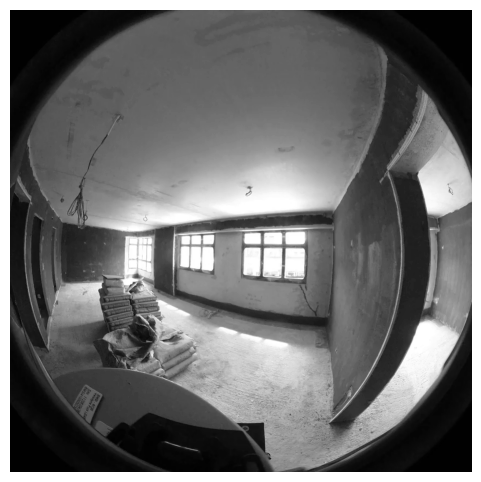

Converted Vid_20230220_110705_10_012_resize_rotated_ver_2_frame_1800.png to black and white.


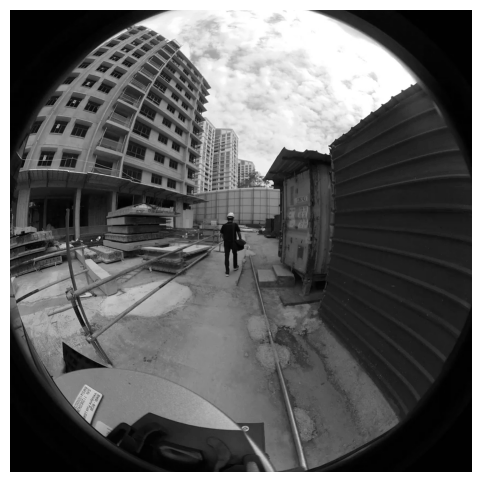

Converted Vid_20230220_110705_10_012_resize_rotated_ver_2_frame_32700.png to black and white.


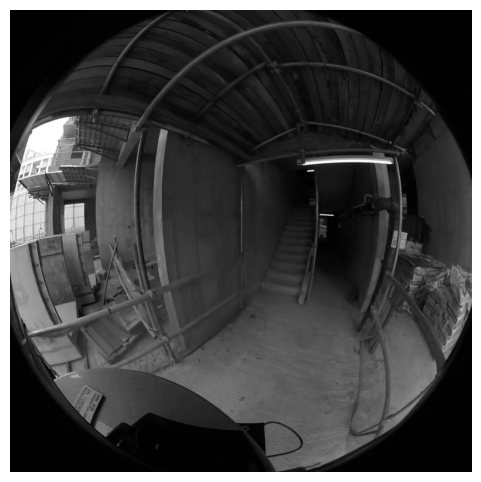

Converted Vid_20230220_110705_10_012_resize_rotated_ver_2_frame_34500.png to black and white.


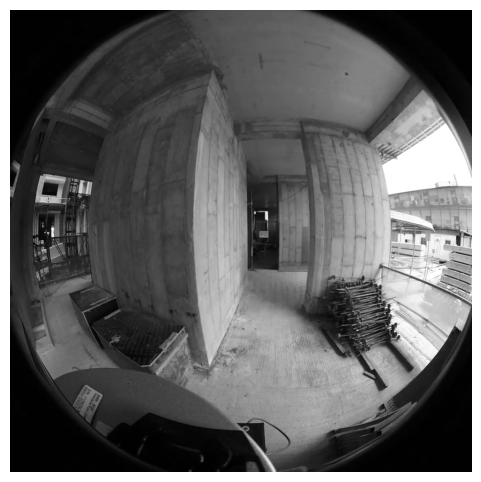

Converted Vid_20230220_110705_10_012_resize_rotated_ver_2_frame_34800.png to black and white.


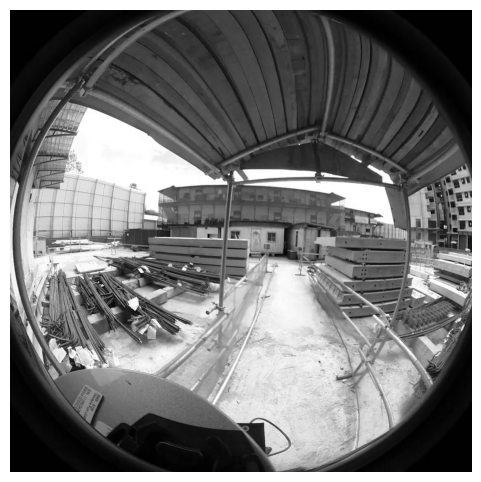

In [2]:
import os
from PIL import Image
import matplotlib.pyplot as plt

def convert_to_bw(directory):
    for filename in os.listdir(directory):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            image_path = os.path.join(directory, filename)
            img = Image.open(image_path).convert('L')
            img.save(image_path)
            print(f"Converted {filename} to black and white.")
            display_img(img)

def display_img(img):
    plt.figure(figsize=(6,6))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    plt.show()

# Change the directory path to your specific path
dir_path = r"C:\Users\Adrian\Desktop\projects\segment-anything-annotator\dataset\valid\images"
convert_to_bw(dir_path)
